In [1]:
## Import Packages
from __future__ import print_function

import numpy as np
import pandas as pd
from itertools import product

#Astro Software
import astropy.units as units
from astropy.coordinates import SkyCoord
from astropy.io import fits

from dustmaps.sfd import SFDQuery
from dustmaps.planck import PlanckQuery
from dustmaps.bayestar import BayestarQuery

#from brutus import pdf
#import brutus

import dynesty
from dynesty import plotting as dyplot
from dynesty import utils as dyfunc

#Plotting Packages
import matplotlib as mpl
import matplotlib.cm as cmplt
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib.colors import LogNorm
from matplotlib.colors import ListedColormap

import seaborn as sns

from PIL import Image, ImageDraw

from yt.config import ytcfg
import yt
from yt.analysis_modules.ppv_cube.api import PPVCube
import yt.units as u

#Scattering NN
import torch
import torch.nn.functional as F
from torch import optim
from kymatio.torch import Scattering2D
device = "cpu"

#Machine Learning
from sklearn.model_selection import train_test_split
from sklearn.mixture import GaussianMixture
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis as QDA
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.decomposition import PCA, FastICA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error

import skimage
from skimage import filters as skfilters
from skimage.filters import window

import cv2

from scipy.optimize import curve_fit
from scipy import linalg
from scipy import stats
from scipy.signal import general_gaussian
from scipy.ndimage import map_coordinates

# from scipy.sparse import csr_matrix
from scipy.sparse import csc_matrix
from scipy.sparse.csgraph import reverse_cuthill_mckee

#I/O
import h5py
import pickle
import glob
import copy
import time
import os
from bs4 import BeautifulSoup
import scipy.io as sio

#Plotting Style
%matplotlib inline
plt.style.use('dark_background')
rcParams['text.usetex'] = True
rcParams['axes.titlesize'] = 20
rcParams['xtick.labelsize'] = 16
rcParams['ytick.labelsize'] = 16
rcParams['legend.fontsize'] = 12
rcParams['axes.labelsize'] = 20
rcParams['font.family'] = 'sans-serif'

#Threading
torch.set_num_threads=2

import ntpath
def path_leaf(path):
    head, tail = ntpath.split(path)
    out = os.path.splitext(tail)[0]
    return out

def hd5_open(file_name,name):
    f=h5py.File(file_name,'r', swmr=True)
    data = f[name][:]
    f.close()
    return data

from matplotlib.colors import LinearSegmentedColormap
cdict1 = {'red':   ((0.0, 0.0, 0.0),
                   (0.5, 0.0, 0.0),
                   (1.0, 1.0, 1.0)),

         'green': ((0.0, 0.0, 0.0),
                   (1.0, 0.0, 0.0)),

         'blue':  ((0.0, 0.0, 1.0),
                   (0.5, 0.0, 0.0),
                   (1.0, 0.0, 0.0))
        }
blue_red1 = LinearSegmentedColormap('BlueRed1', cdict1,N=5000)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/ipykernel_launcher.py:38: VisibleDeprecationWarning: Development of the PPVCube module has been moved to the yt_astro_analysis package. This version is deprecated and will be removed from yt in a future release. See https://github.com/yt-project/yt_astro_analysis for further information.


In [2]:
def DHC_reader_iso(data,S0_on = 1,S1_on = 1, S20_on = 1, S12_on = 1):
    L = 8
    data = np.array(data)
    data0 = np.array([data[i,0].flatten() for i in range(13824)])
    
    data1_raw = np.array([data[i,1] for i in range(13824)])
    data1_iso = np.array([np.sum(data1_raw[i,:,:],axis=1) for i in range(13824)])
    data1 = np.array([data1_iso[i,:].flatten() for i in range(13824)])
    
    data2_raw = np.array([data[i,2] for i in range(13824)])
    data2_iso = [np.sum([data2_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data2_iso = np.moveaxis(np.array(data2_iso), 0, -1)
    
    data2 = np.array([data2_iso[i,:,:,:].flatten() for i in range(13824)])
    
    data3_raw = np.array([data[i,2] for i in range(13824)])
    data3_iso = [np.sum([data3_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data3_iso = np.moveaxis(np.array(data3_iso), 0, -1)
    
    data3 = np.array([data3_iso[i,:,:,:].flatten() for i in range(13824)])
    
    if np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data1,data3))
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1))
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2))
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 1]):
        out = data1
        
    elif np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 0]):
        out = np.hstack((data0,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 0]):
        out = data3
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 0]):
        out = data0
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 0]):
        out = data2
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 0]):
        out = np.hstack(([]))
        
    return out

In [3]:
def LDA_AKS_testman(X_train,y_train,X_test,y_test,n_components,label_list):
    lda = LDA(n_components=n_components)
    X_train = lda.fit_transform(X_train, y_train)
    y_pred = lda.predict(X_test)
    X_test = lda.transform(X_test)
    cm = confusion_matrix(y_test, y_pred)
    prec = precision_score(y_test, y_pred,average='micro')
    print(cm)
    print('Accuracy' + str(prec))
    cmap_normal = (cm.T/cm.sum(axis=1)).T
    
    fig = plt.figure(figsize=(10,10),dpi=150)

    ax = fig.add_subplot(2,2,1)
    ax.imshow(cmap_normal,cmap='gray',vmin=0,vmax=1)

    ax.set_xticks(np.arange(cm.shape[0]))
    ax.set_yticks(np.arange(cm.shape[1]))

    ax.set_xticklabels(label_list)
    ax.set_yticklabels(label_list)

    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')

    plt.setp(ax.get_xticklabels(), rotation=90, ha="right",va='center',
             rotation_mode="anchor")
    plt.title('Test-Train Fidelity ({:.0f}\%)'.format(100*prec))

    # Loop over data dimensions and create text annotations.
    textcolors=["black", "white"]
    threshold = 0.5
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            if cm[i, j] != 0:
                text = ax.text(j, i, cm[i, j],
                               ha="center", va="center", color=textcolors[int(cmap_normal[i, j] < threshold)])
    if n_components == 1:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train, y_train, s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        #ax.scatter(X_test, y_test, s=2, marker='^', zorder=10,c=y_test, cmap = 'bwr',alpha=0.5)
        sns.distplot(X_test[y_test==0],ax=ax)
        sns.distplot(X_test[y_test==1],ax=ax)
        plt.xlabel('$LDA_{}$'.format(0))
        plt.ylabel('Probability Density')
        plt.title('LDA Projection')
        
    if n_components == 2:
        ax = fig.add_subplot(2,2,2)
        #ax.scatter(X_train[:,0], X_train[:,1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
        ax.scatter(X_test[:,0], X_test[:,1], s=2, marker='^', zorder=10,c=y_test, cmap = 'bwr',alpha=0.5)
        plt.xlabel('$LDA_{}$'.format(i-2))
        plt.ylabel('$LDA_{}$'.format(i-1))
        plt.title('LDA Projection')
    elif n_components > 2:
        for i in range(2,5):
            ax = fig.add_subplot(2,2,i)
            #ax.scatter(X_train[:,i-2], X_train[:,i-1], s=2, marker='o', zorder=10,c=y_train, cmap = 'bwr',alpha=0.5)
            ax.scatter(X_test[:,i-2], X_test[:,i-1], s=2, marker='^', zorder=10,c=y_test, cmap = 'bwr',alpha=0.5)
            plt.xlabel('$LDA_{}$'.format(i-2))
            plt.ylabel('$LDA_{}$'.format(i-1))
            plt.title('LDA Projection')

    fig.subplots_adjust(wspace=0.6, hspace=0.6)
    plt.show()
    
    return (lda,cm,X_train,X_test,y_train,y_test,y_pred)

In [4]:
with open('FromCannon/2020_11_23/DHC_MHD_rinvar_fmor.p', 'rb') as input_file:
    DHC_MHD_rinvar_fmor = np.array(pickle.load(input_file))

In [6]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fmor,S0_on = 0, S20_on = 0,S12_on = 0)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[153  26   0   0   0   0   4   9]
 [ 25 155   8   0   0   0   4   0]
 [  0  14 133   4   0  41   0   0]
 [  0   0   0  94  98   0   0   0]
 [  0   0   0  58 134   0   0   0]
 [  0   1  21   4   8 156   2   0]
 [  1  20   0   0   0   7 154  10]
 [ 36   2   0   0   0   0  18 136]]
Accuracy0.7259114583333334


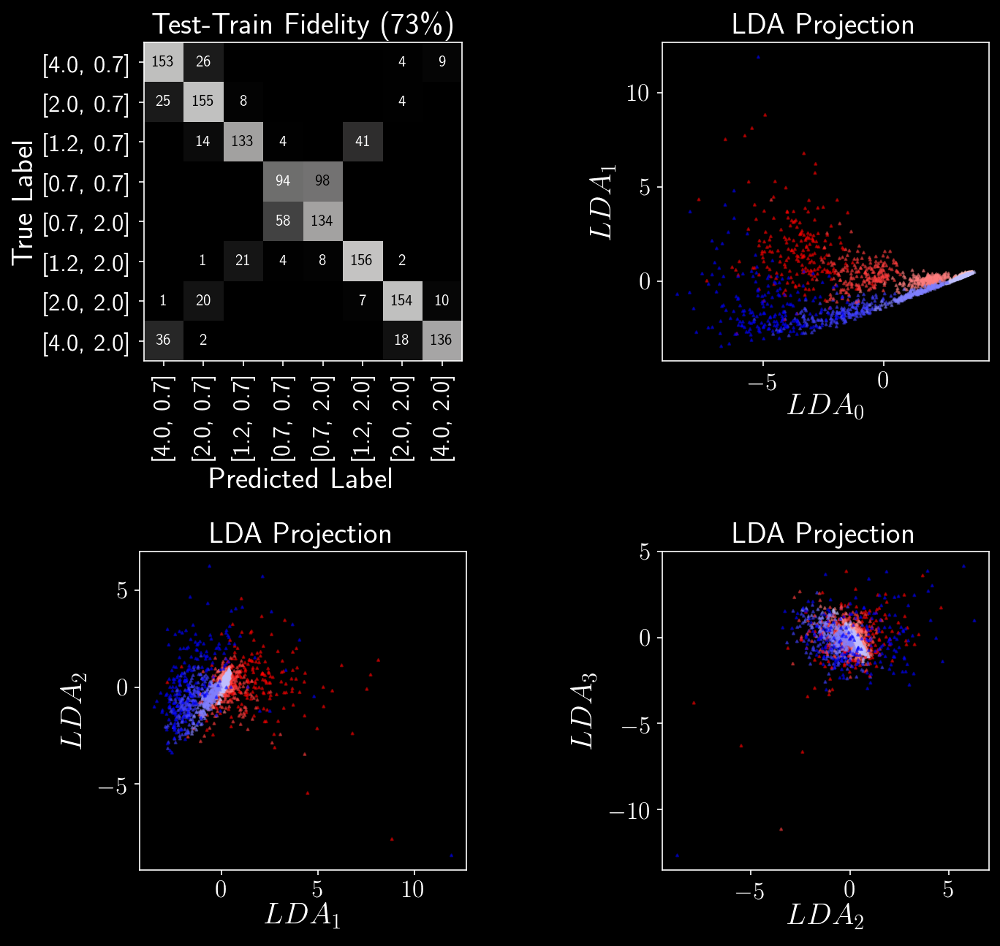

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[149  28   0   0   0   0   2  13]
 [ 22 161   7   0   0   0   2   0]
 [  0  14 133   4   0  41   0   0]
 [  0   0   0  94  98   0   0   0]
 [  0   0   0  58 134   0   0   0]
 [  0   1  23   6   8 152   2   0]
 [  0  27   5   0   0  13 130  17]
 [ 15   2   0   0   0   0  12 163]]
Accuracy0.7265625


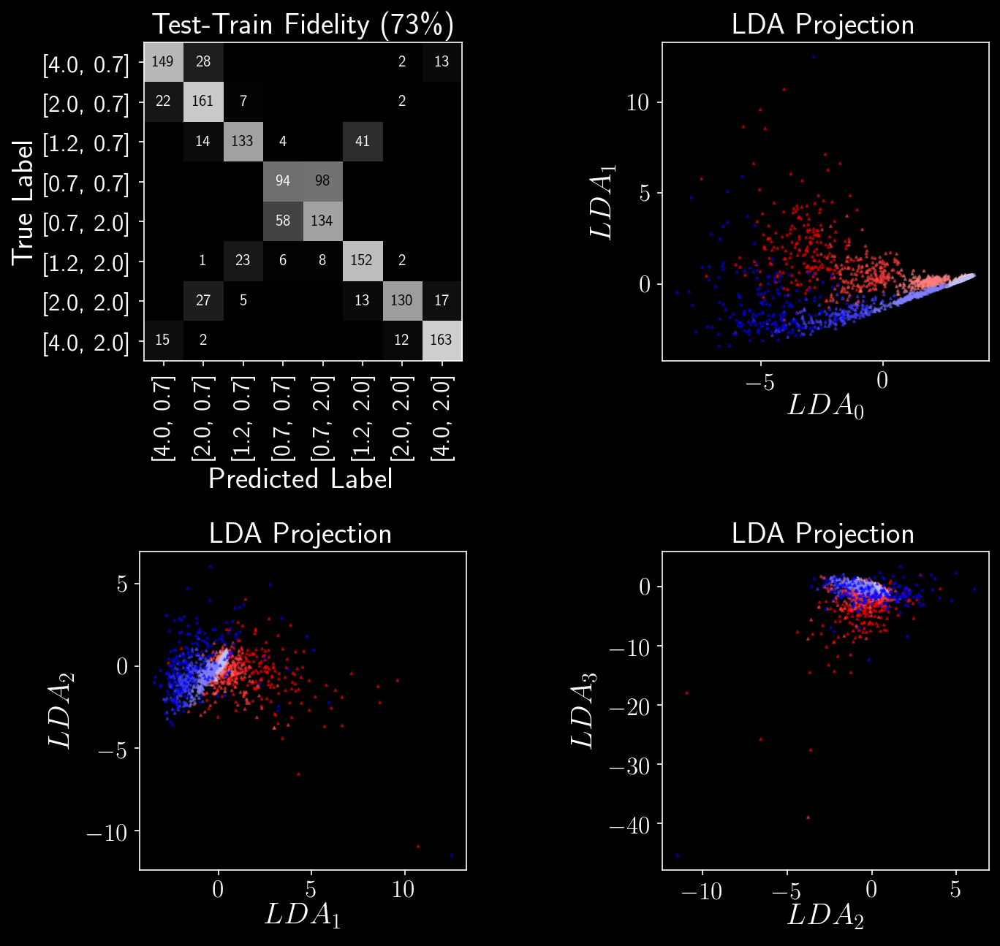

In [8]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

sc = StandardScaler()
data_pre = sc.fit_transform(out1)
data_in = data_pre

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==6,
                np.remainder(ele[0],9)==2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=6,
                 np.remainder(ele[0],9)!=2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==6,
                np.remainder(ele[0],9)==2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=6,
                 np.remainder(ele[0],9)!=2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[154  25   0   0   0   0   2  11]
 [ 32 156   3   0   0   0   1   0]
 [  0  16 169   4   0   3   0   0]
 [  0   0   0 188   4   0   0   0]
 [  0   0   0   8 184   0   0   0]
 [  0   1   6   0   1 178   6   0]
 [  3   4   0   0   0   0 169  16]
 [ 22   0   0   0   0   0  15 155]]
Accuracy0.880859375


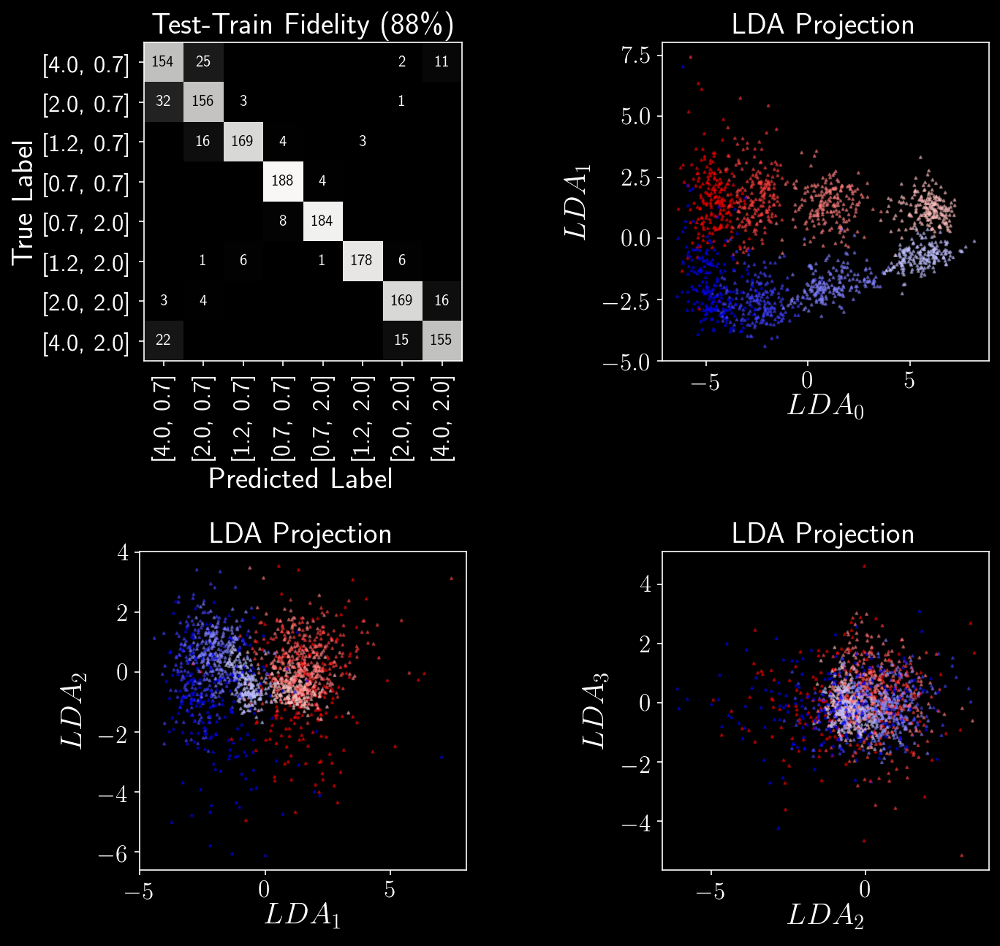

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[115  23   0   0   0   0   8  46]
 [ 27 154   4   0   0   0   6   1]
 [  0  15 169   4   0   3   1   0]
 [  0   0   0 186   6   0   0   0]
 [  0   0   0   3 189   0   0   0]
 [  0   0   0   0   0 182  10   0]
 [  0   0   0   0   0   0 170  22]
 [  4   0   0   0   0   0  14 174]]
Accuracy0.8717447916666666


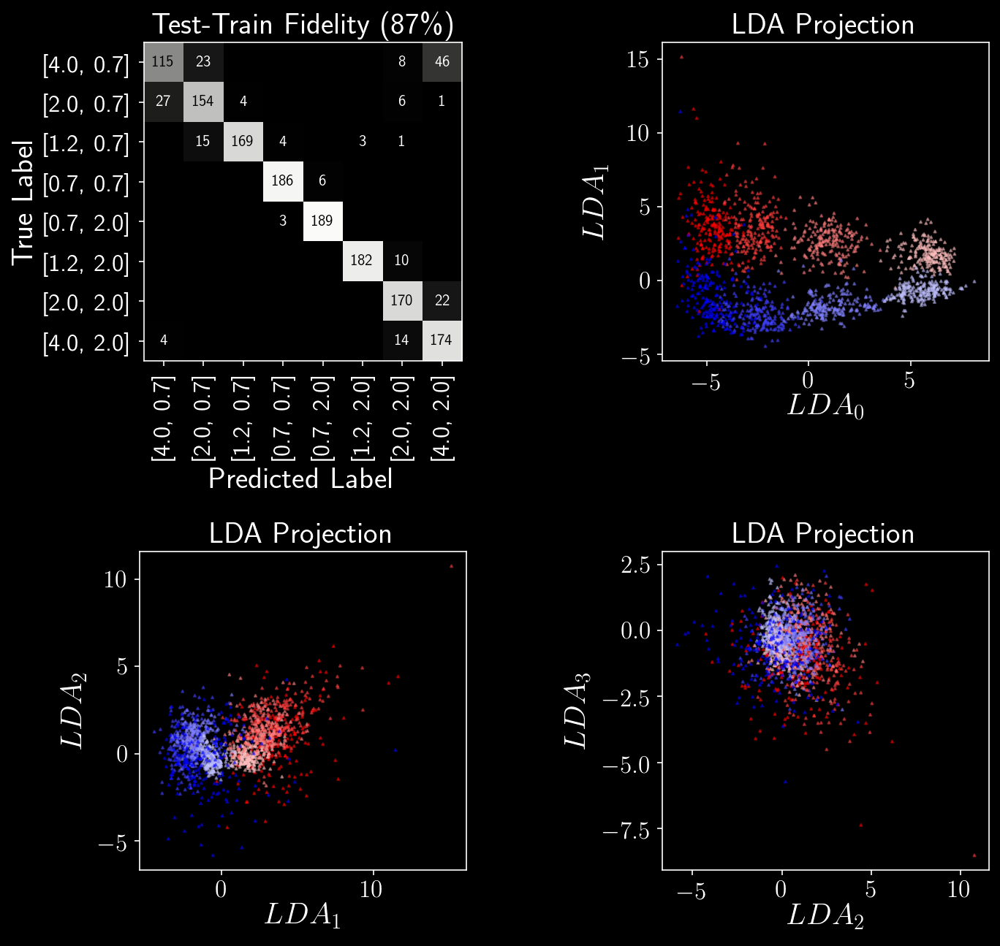

In [11]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==6,
                np.remainder(ele[0],9)==2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=6,
                 np.remainder(ele[0],9)!=2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==6,
                np.remainder(ele[0],9)==2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=6,
                 np.remainder(ele[0],9)!=2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[130  24   1   0   0   0   3  34]
 [  8 154  28   0   0   0   2   0]
 [  0   4 149  26   0  13   0   0]
 [  0   0   9 182   1   0   0   0]
 [  0   0   0  23 169   0   0   0]
 [  0   4  11   2   5 168   2   0]
 [  2   4   0   0   0   6 169  11]
 [ 16   0   0   0   0   0  22 154]]
Accuracy0.830078125


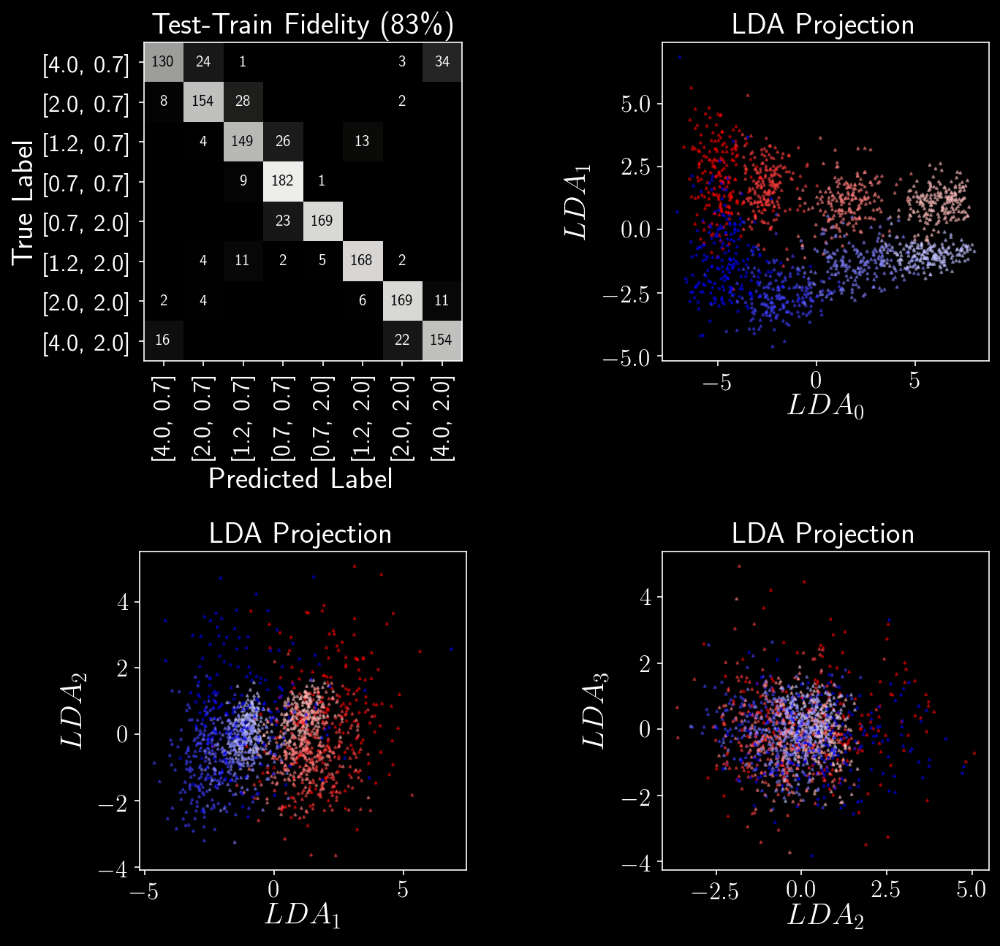

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[ 88  22   1   0   0   0   9  72]
 [  7 149  28   0   0   0   8   0]
 [  0   3 140  25   1  23   0   0]
 [  0   0   9 182   1   0   0   0]
 [  0   0   0  14 177   1   0   0]
 [  0   1   3   2   4 177   5   0]
 [  1   1   0   0   0   4 177   9]
 [  0   0   0   0   0   0  25 167]]
Accuracy0.818359375


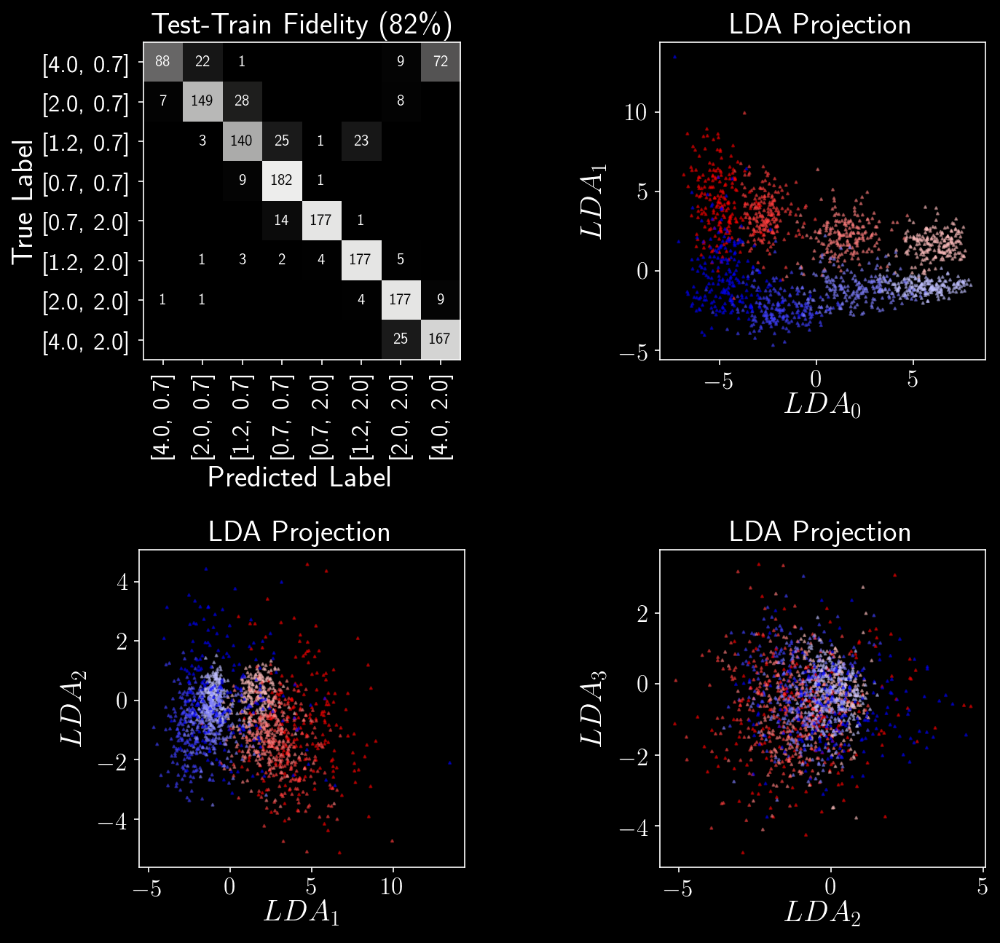

In [12]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==5,
                np.remainder(ele[0],9)==1),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=5,
                 np.remainder(ele[0],9)!=1),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==5,
                np.remainder(ele[0],9)==1),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=5,
                 np.remainder(ele[0],9)!=1),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[151  12   0   0   0   0   2  27]
 [ 16 148  17   0   0   2   9   0]
 [  0  14 162   7   0   9   0   0]
 [  0   0   3 178  10   1   0   0]
 [  0   0   0  18 172   2   0   0]
 [  0   0   1   0   0 175  16   0]
 [  2   1   0   0   0   4 168  17]
 [ 12   0   0   0   0   0  28 152]]
Accuracy0.8502604166666666


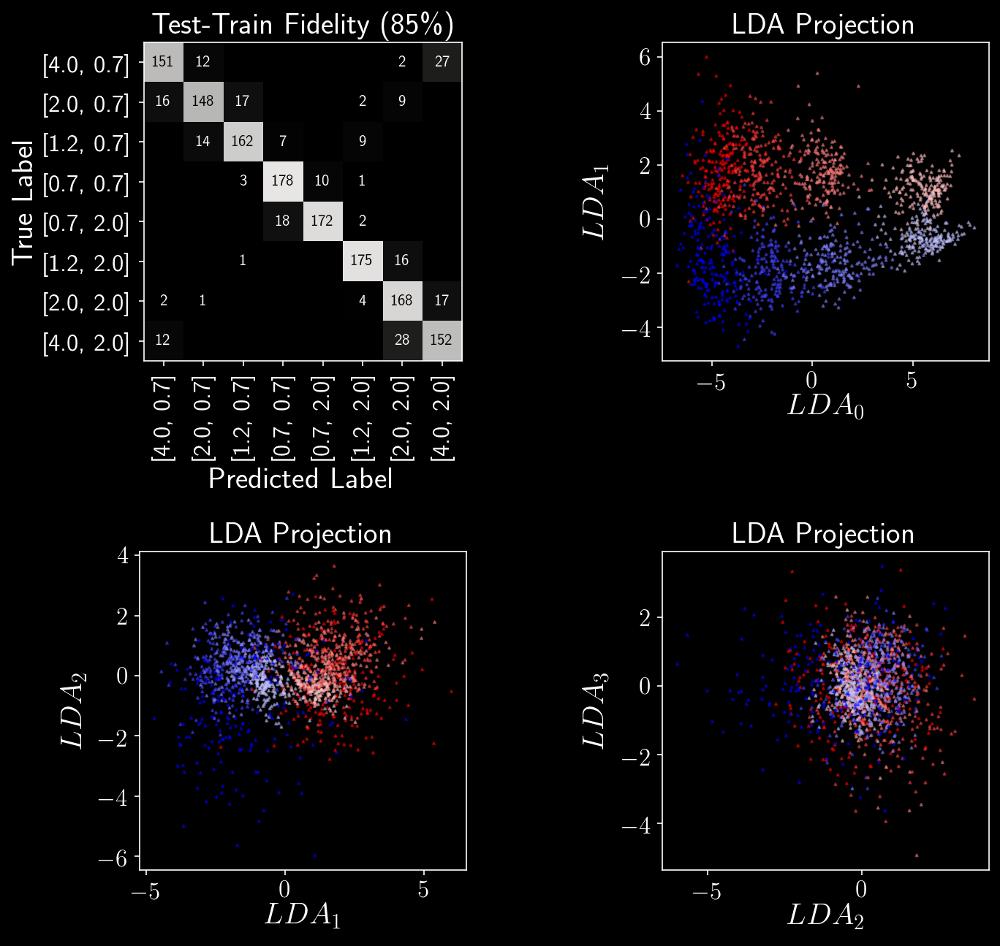

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[107  12   0   0   0   0   2  71]
 [ 14 130  17   0   0   1  28   2]
 [  0  13 154   7   0  16   2   0]
 [  0   0   2 176  11   3   0   0]
 [  0   0   0  12 173   7   0   0]
 [  0   0   0   0   0 152  40   0]
 [  0   0   0   0   0   1 162  29]
 [  1   0   0   0   0   0  14 177]]
Accuracy0.8014322916666666


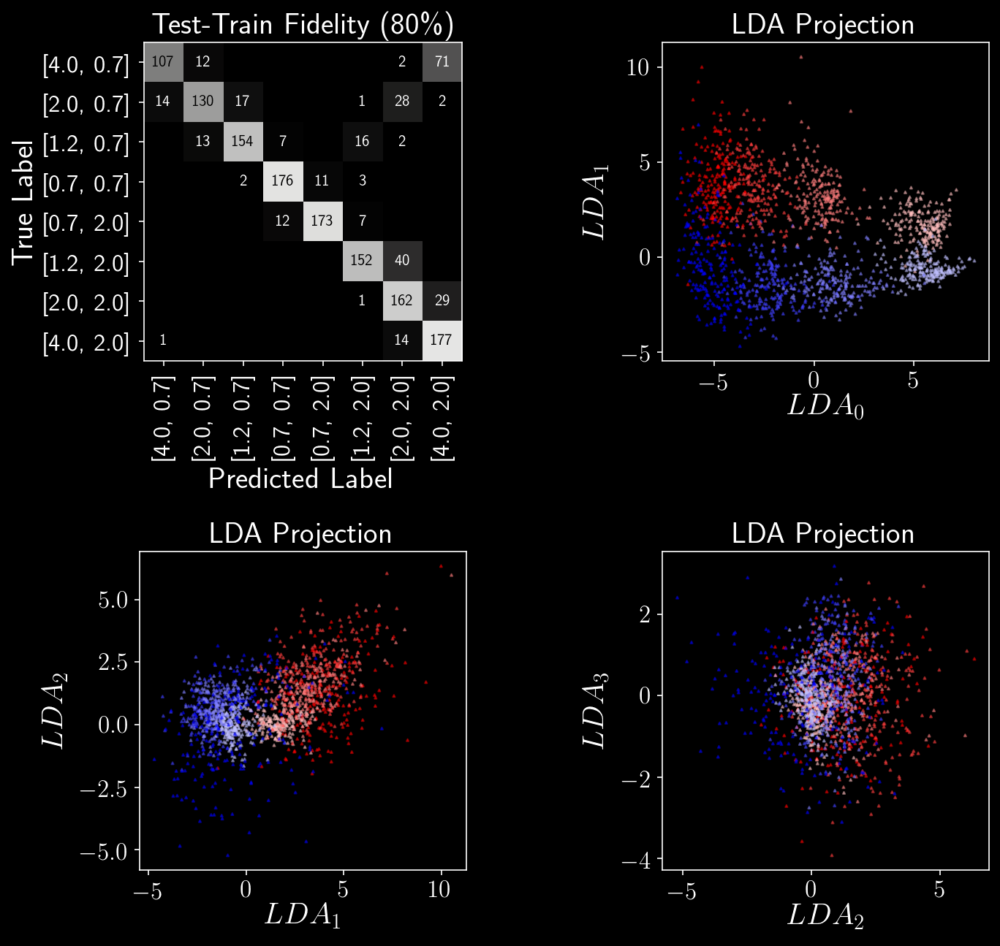

In [13]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 7
train2 = 3

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[155  15   0   0   0   0   3  19]
 [ 17 145  18   1   0   2   9   0]
 [  0  12 169   9   0   2   0   0]
 [  0   0   0 184   8   0   0   0]
 [  0   0   0  18 172   2   0   0]
 [  0   0   4   0   0 182   6   0]
 [  3   2   0   0   0   3 176   8]
 [ 11   0   0   0   0   0  48 133]]
Accuracy0.8567708333333334


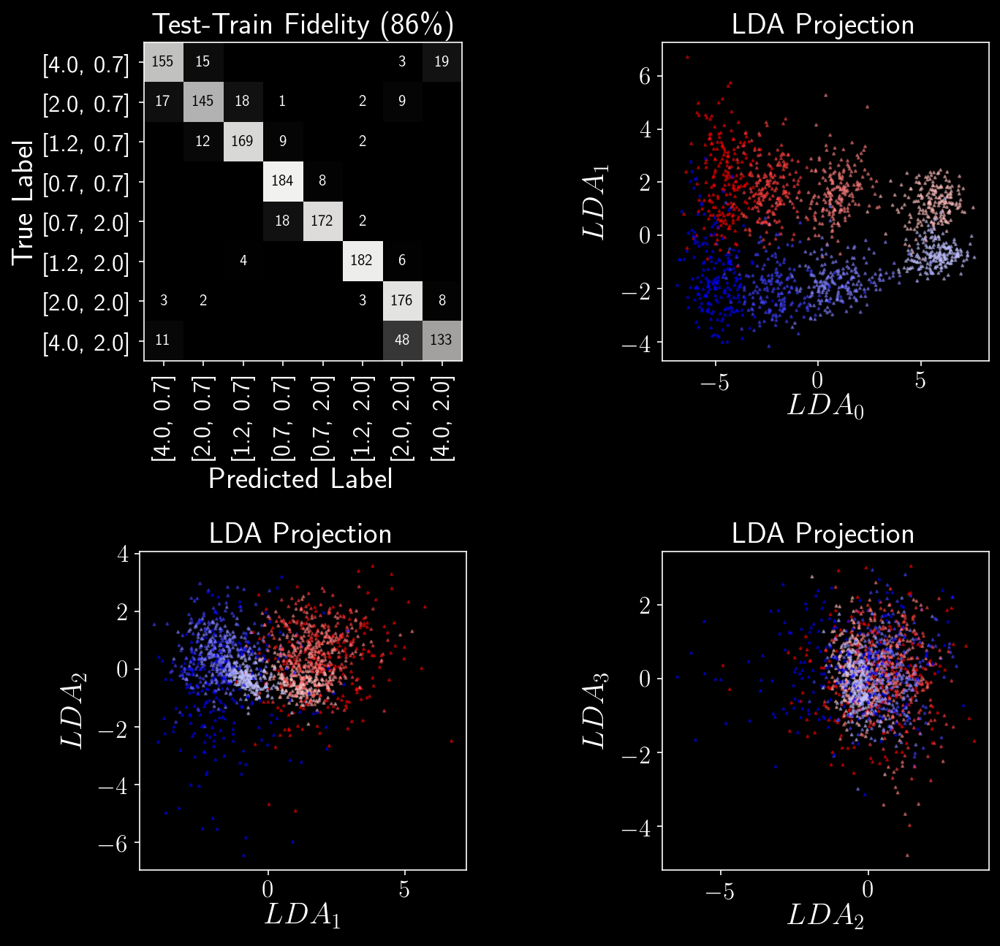

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[112  14   0   0   0   0   5  61]
 [ 12 132  18   1   0   0  24   5]
 [  0  12 160   8   0  11   1   0]
 [  0   0   0 181  11   0   0   0]
 [  0   0   0  13 175   4   0   0]
 [  0   0   2   0   0 174  16   0]
 [  0   0   0   0   0   2 173  17]
 [  0   0   0   0   0   0  34 158]]
Accuracy0.8235677083333334


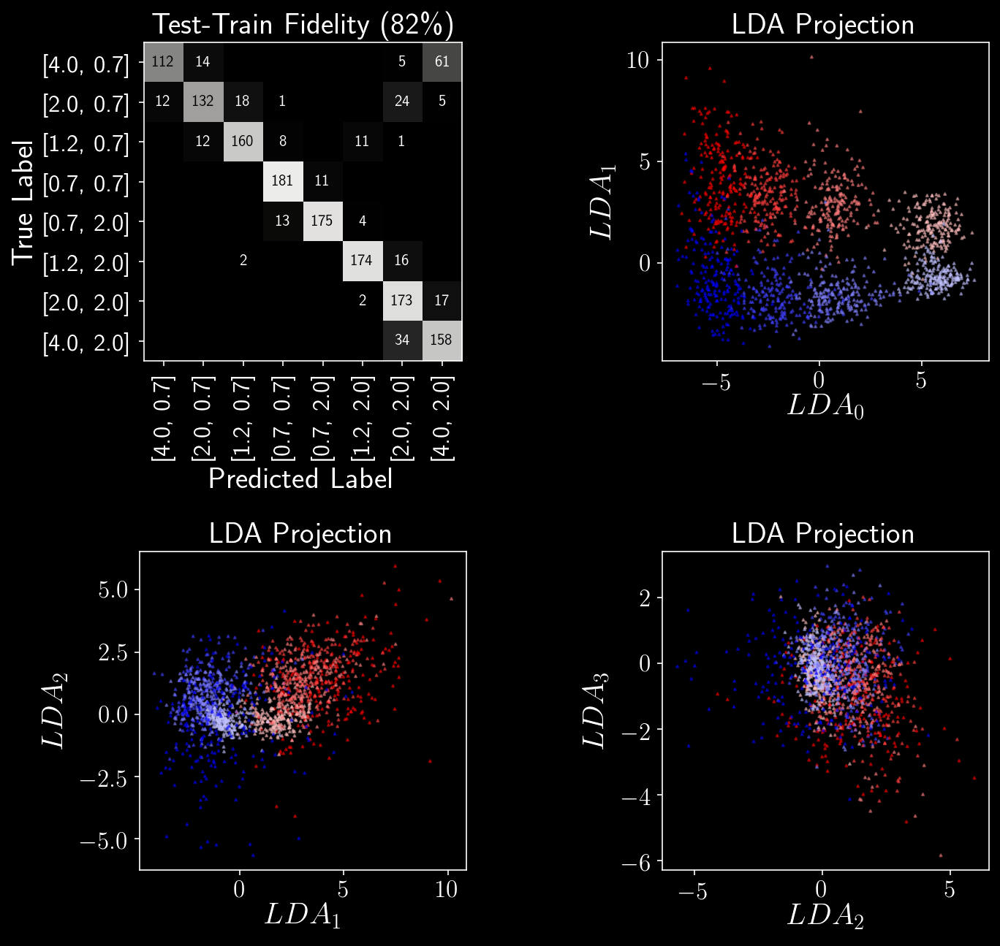

In [14]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 4
train2 = 3

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [15]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fmor,S0_on = 0, S20_on = 1,S12_on = 0)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[167  16   0   0   0   0   1   8]
 [ 24 146  21   1   0   0   0   0]
 [  0  17 169   5   0   1   0   0]
 [  0   0   0 186   6   0   0   0]
 [  0   0   0  10 180   2   0   0]
 [  0   1   1   0   0 190   0   0]
 [  0   0   0   0   0   2 179  11]
 [  5   0   0   0   0   0  45 142]]
Accuracy0.884765625


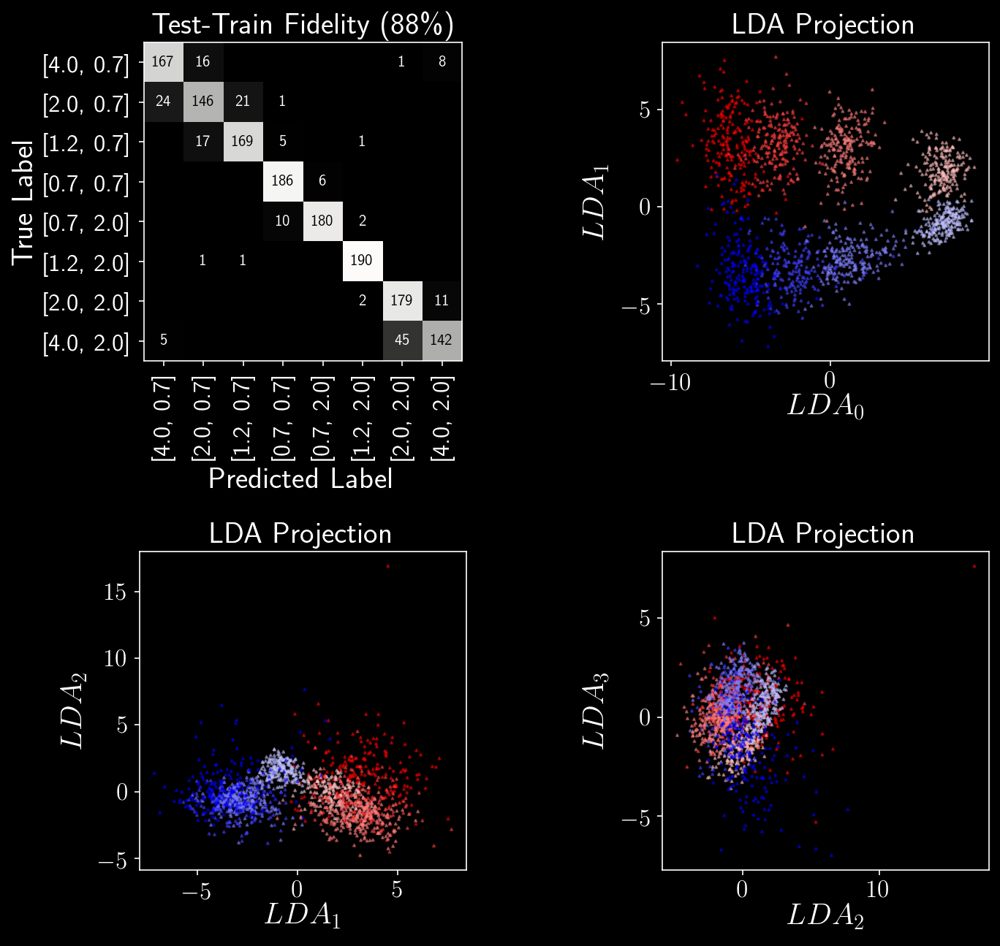

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[114  20   0   0   0   0   8  50]
 [ 12 137  24   1   0   6  11   1]
 [  0  10 170   5   0   7   0   0]
 [  0   0   2 162  28   0   0   0]
 [  0   0   0   3 185   4   0   0]
 [  0   0   0   0   0 170  22   0]
 [  1   0   0   0   0   1 174  16]
 [  0   0   1   0   0   0  31 160]]
Accuracy0.828125


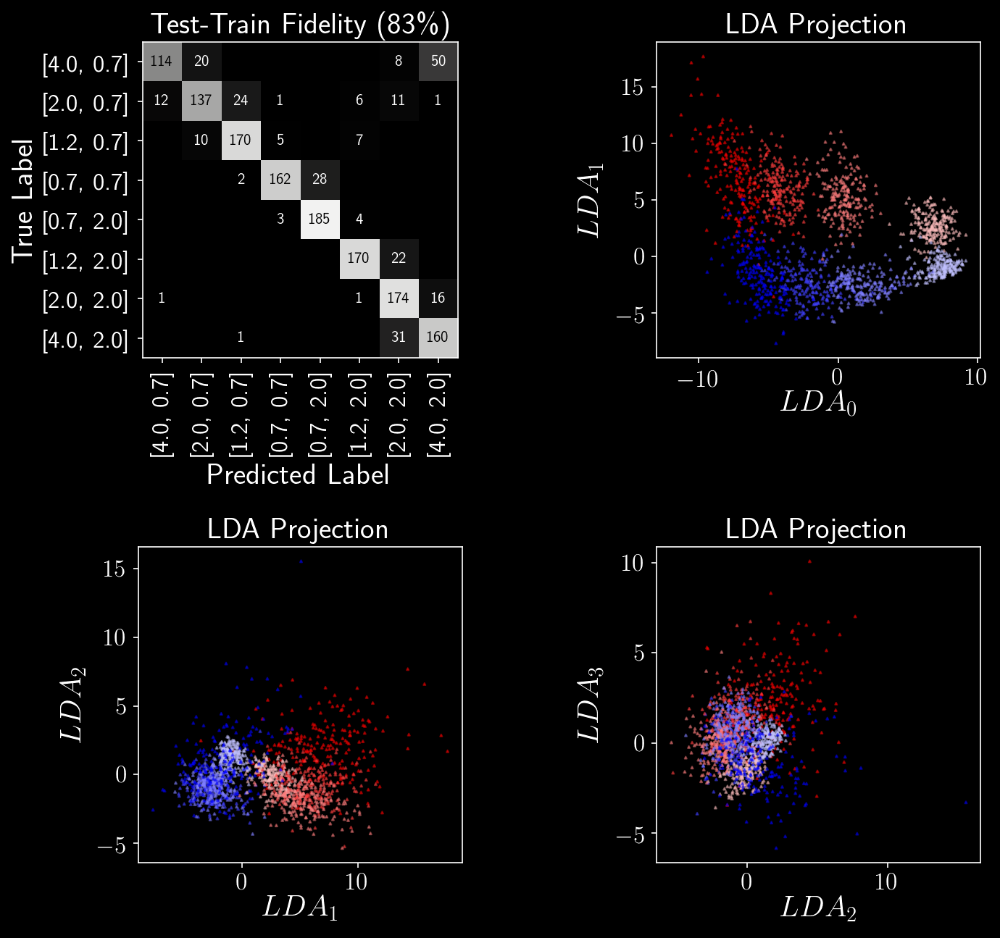

In [16]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 4
train2 = 3

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [17]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fmor,S0_on = 0, S1_on = 0, S20_on = 0,S12_on = 1)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[166  17   0   0   0   0   2   7]
 [ 27 142  22   1   0   0   0   0]
 [  0  13 171   6   1   1   0   0]
 [  0   0   0 186   6   0   0   0]
 [  0   0   0   8 181   3   0   0]
 [  0   1   1   0   0 189   1   0]
 [  0   0   0   0   0   8 170  14]
 [  3   0   0   0   0   0  47 142]]
Accuracy0.876953125


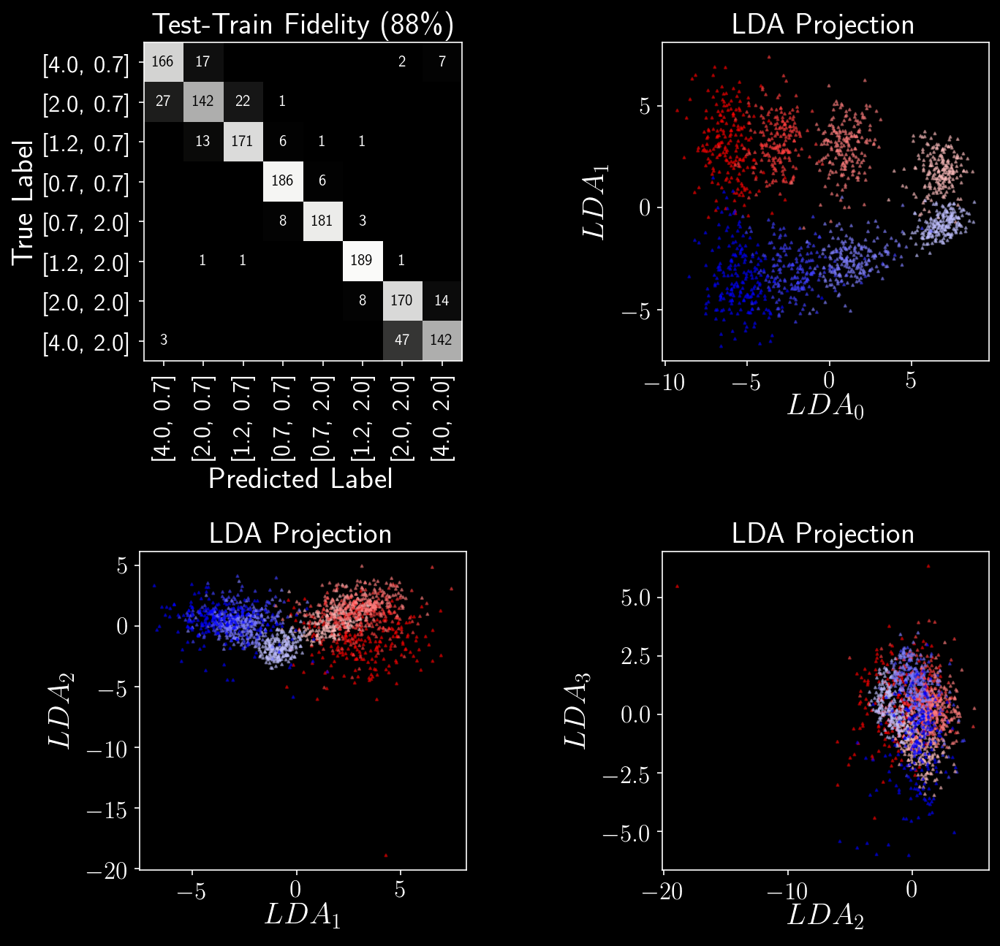

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[120  16   0   0   0   0   8  48]
 [ 18 127  27   1   0   6  12   1]
 [  0  15 162  10   0   5   0   0]
 [  0   0   0 151  41   0   0   0]
 [  0   0   0   3 184   5   0   0]
 [  0   0   0   0   0 175  17   0]
 [  1   0   0   0   0   1 172  18]
 [  0   0   1   0   0   0  35 156]]
Accuracy0.8118489583333334


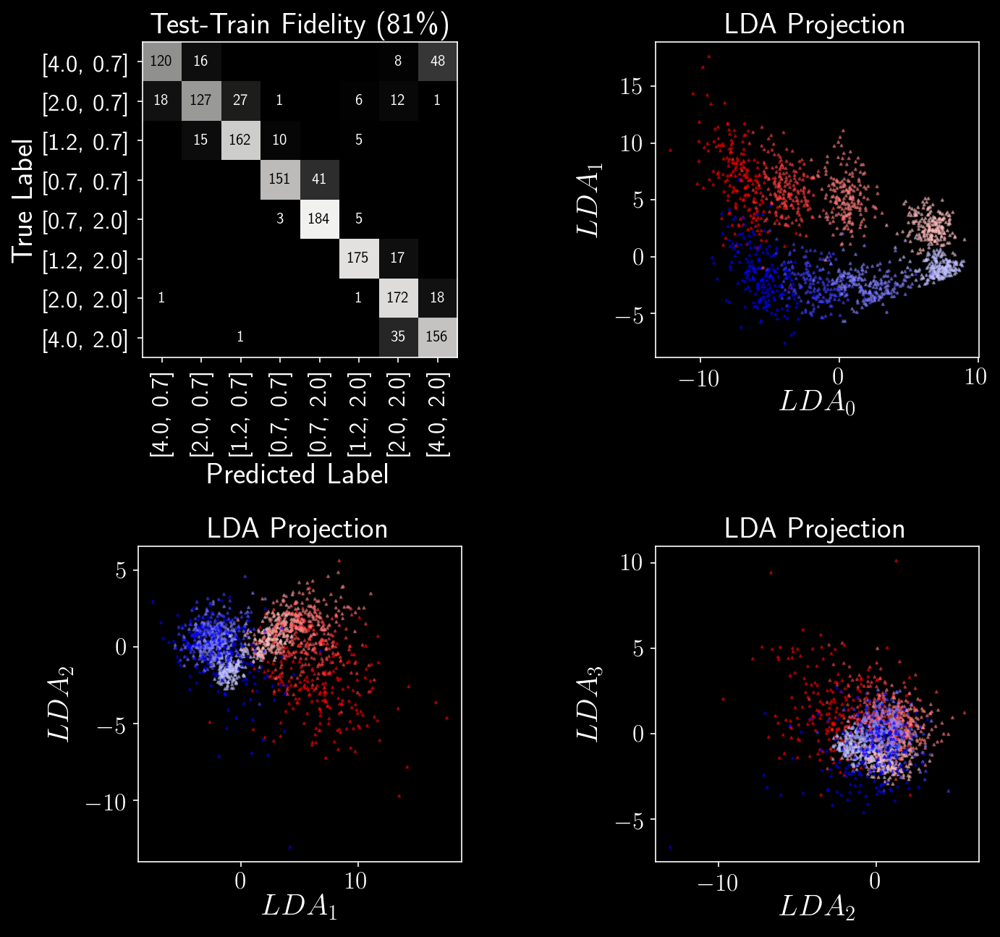

In [18]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 4
train2 = 3

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [19]:
def DHC_reader_iso(data,S0_on = 1,S1_on = 1, S20_on = 1, S12_on = 1):
    L = 16
    data = np.array(data)
    data0 = np.array([data[i,0].flatten() for i in range(13824)])
    
    data1_raw = np.array([data[i,1] for i in range(13824)])
    data1_iso = np.array([np.sum(data1_raw[i,:,:],axis=1) for i in range(13824)])
    data1 = np.array([data1_iso[i,:].flatten() for i in range(13824)])
    
    data2_raw = np.array([data[i,2] for i in range(13824)])
    data2_iso = [np.sum([data2_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data2_iso = np.moveaxis(np.array(data2_iso), 0, -1)
    
    data2 = np.array([data2_iso[i,:,:,:].flatten() for i in range(13824)])
    
    data3_raw = np.array([data[i,2] for i in range(13824)])
    data3_iso = [np.sum([data3_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data3_iso = np.moveaxis(np.array(data3_iso), 0, -1)
    
    data3 = np.array([data3_iso[i,:,:,:].flatten() for i in range(13824)])
    
    if np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data1,data3))
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1))
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2))
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 1]):
        out = data1
        
    elif np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 0]):
        out = np.hstack((data0,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 0]):
        out = data3
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 0]):
        out = data0
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 0]):
        out = data2
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 0]):
        out = np.hstack(([]))
        
    return out

In [20]:
with open('FromCannon/2020_11_23/DHC_MHD_rinvar_cumsum_fmor16.p', 'rb') as input_file:
    DHC_MHD_rinvar_cumsum_fmor16 = np.array(pickle.load(input_file))

In [22]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fmor16,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[175   9   0   0   0   0   0   8]
 [  6 185   1   0   0   0   0   0]
 [  0  30 120  32   9   1   0   0]
 [  0   0  16 166  10   0   0   0]
 [  0   0   0  69 123   0   0   0]
 [  1   2   2   0   4 180   3   0]
 [  3   3   0   0   0   8 141  37]
 [ 31   0   0   0   0   0  32 129]]
Accuracy0.7936197916666666


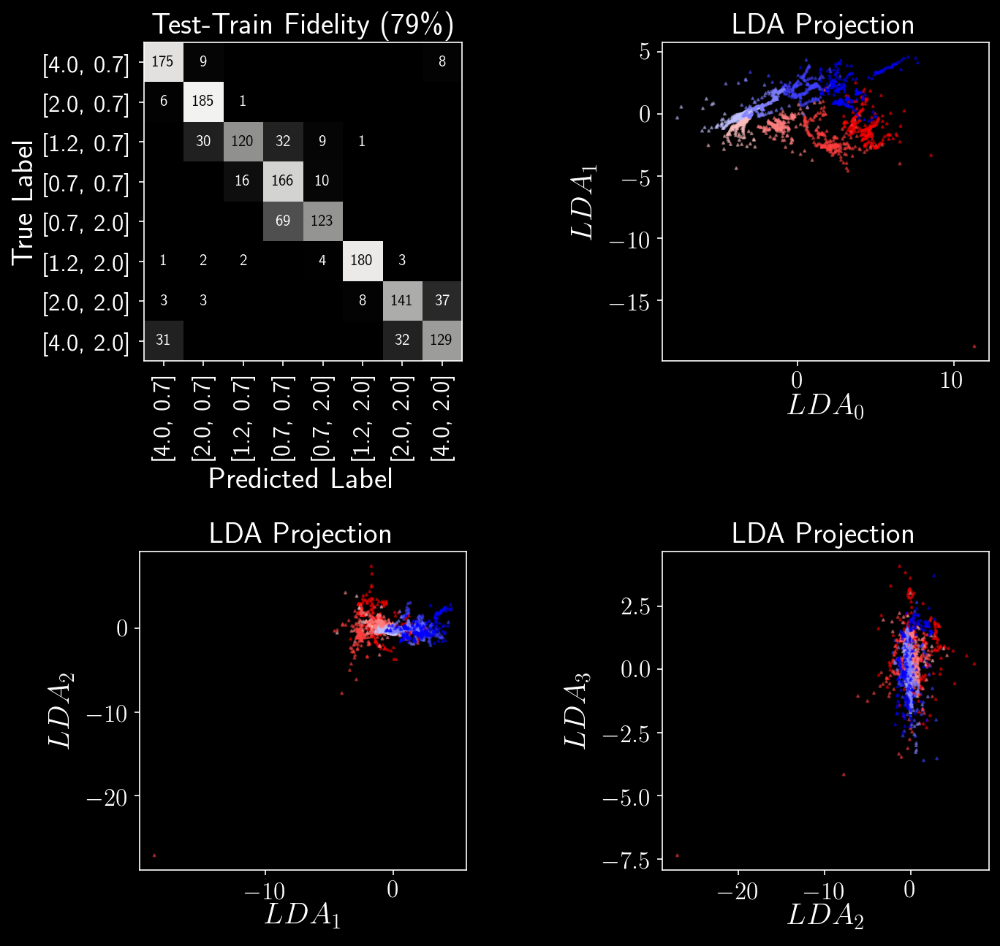

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[112   7   0   0   0   0   3  70]
 [  7 181   3   0   0   0   1   0]
 [  0  28 117  30   8   7   2   0]
 [  0   0  17 167   8   0   0   0]
 [  0   0   0  67 123   2   0   0]
 [  0   0   0   0   2 179   9   2]
 [  2   0   0   0   0   0  62 128]
 [  1   0   0   0   0   0   0 191]]
Accuracy0.7369791666666666


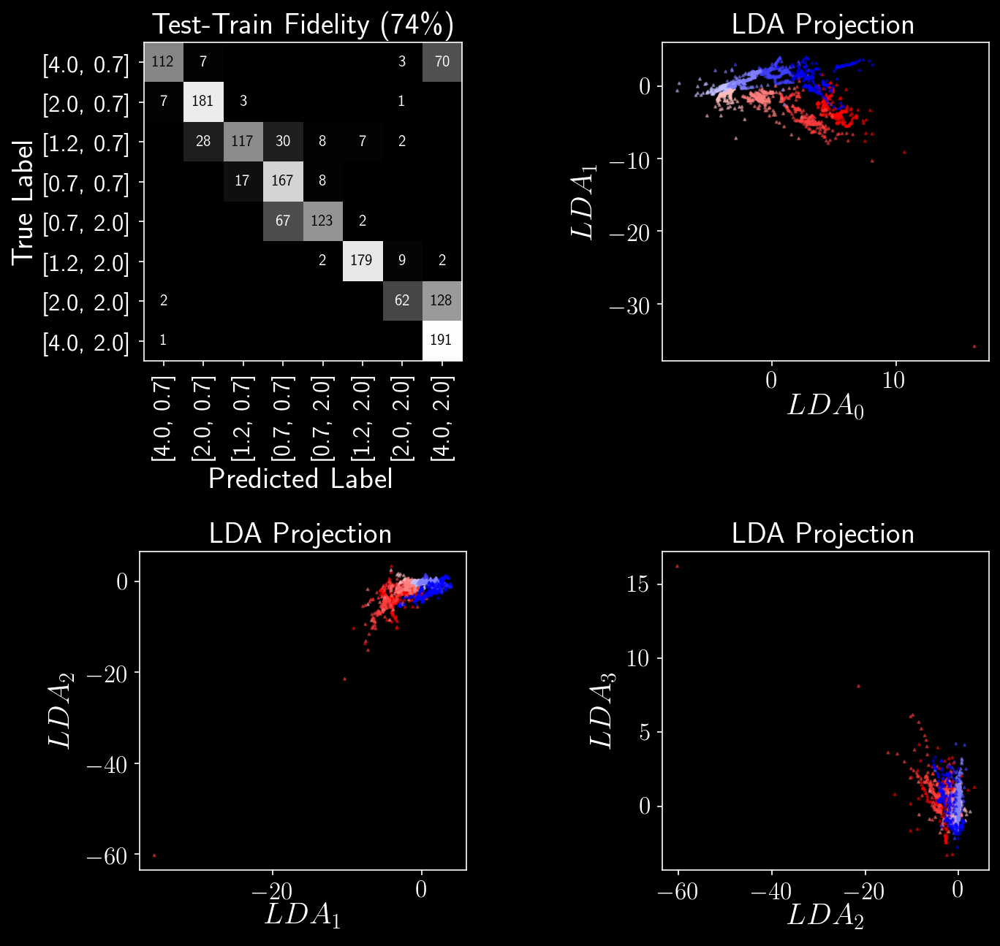

In [23]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[131   4   0   0   0   0   3  54]
 [ 26 132  28   0   0   6   0   0]
 [  0  11 144  34   0   3   0   0]
 [  0   0  25 149  17   1   0   0]
 [  0   0   0  71 116   5   0   0]
 [  0   2   3   0  14 135  38   0]
 [ 17  17   0   0   0  19 135   4]
 [ 15   0   0   0   0   0  33 144]]
Accuracy0.70703125


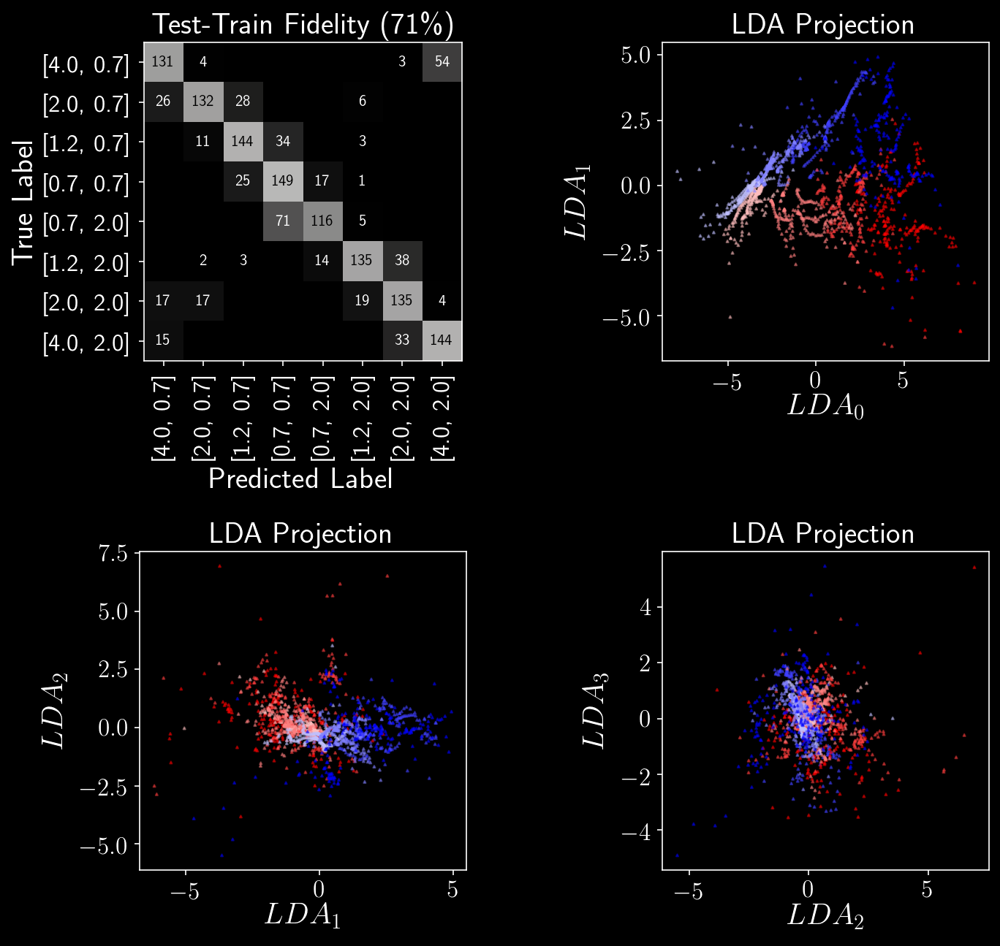

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[ 83   3   0   0   0   0  12  94]
 [ 24 128  30   0   0   9   1   0]
 [  0   6 144  36   0   6   0   0]
 [  0   0  27 152  12   1   0   0]
 [  0   0   0  72 114   6   0   0]
 [  0   0   1   0  12 120  59   0]
 [  1   1   0   0   0   2 147  41]
 [  0   0   0   0   0   0  11 181]]
Accuracy0.6959635416666666


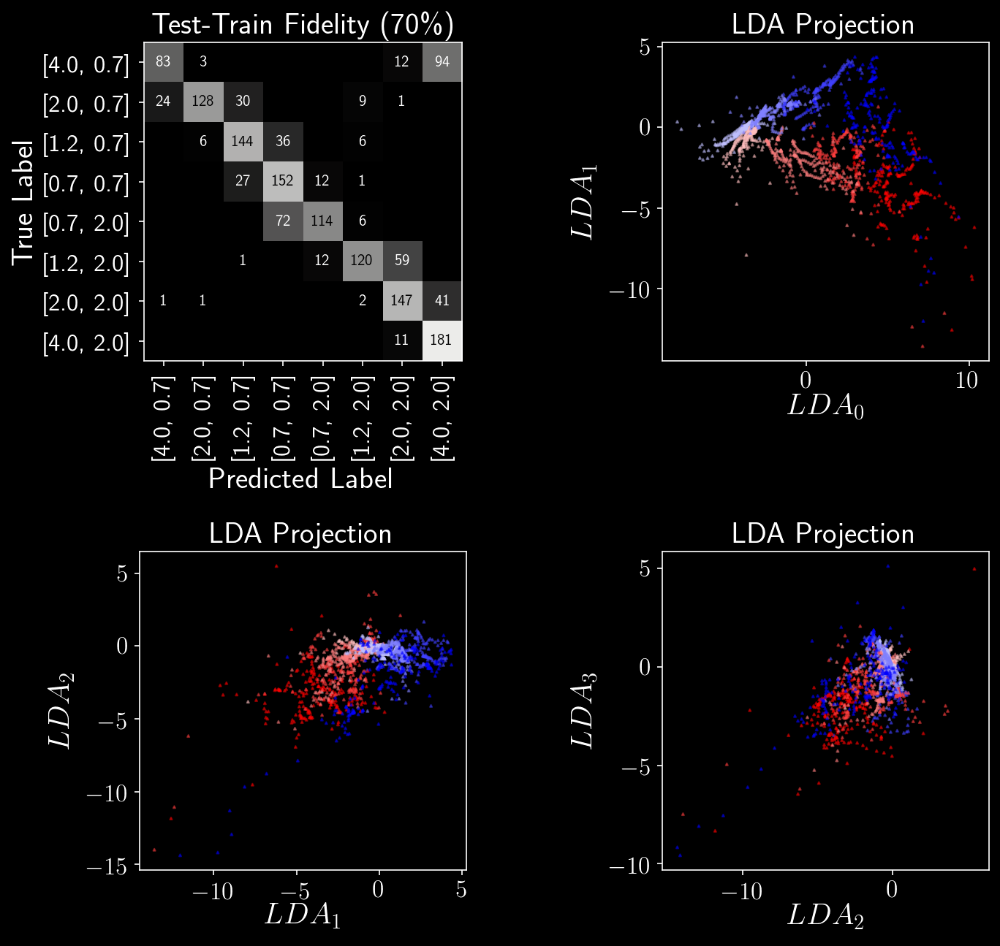

In [24]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 7
train2 = 1

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[168  13   0   0   0   0   0  11]
 [ 38 102  26   0   0   1  25   0]
 [  0  44 111  36   1   0   0   0]
 [  0   0   0 181  11   0   0   0]
 [  0   0   0  56 128   8   0   0]
 [  0   3   8   0   0 167  14   0]
 [  7   0   0   0   0   0 150  35]
 [ 41   0   0   0   0   0  44 107]]
Accuracy0.7252604166666666


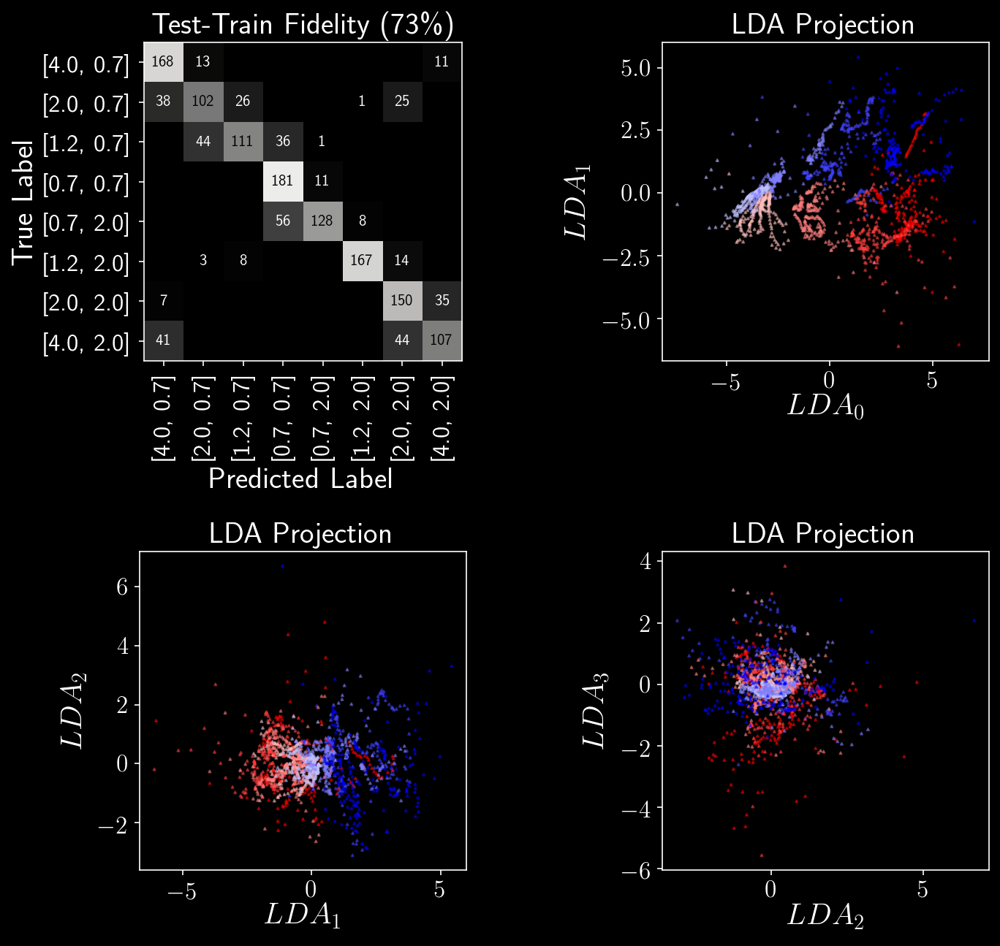

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[131  10   0   0   0   0   1  50]
 [ 36  98  25   0   0   6  26   1]
 [  0  44 112  35   1   0   0   0]
 [  0   0   0 186   6   0   0   0]
 [  0   0   0  54 128  10   0   0]
 [  0   0   0   0   0 164  23   5]
 [  0   0   0   0   0   0 105  87]
 [ 13   0   0   0   0   0  25 154]]
Accuracy0.7018229166666666


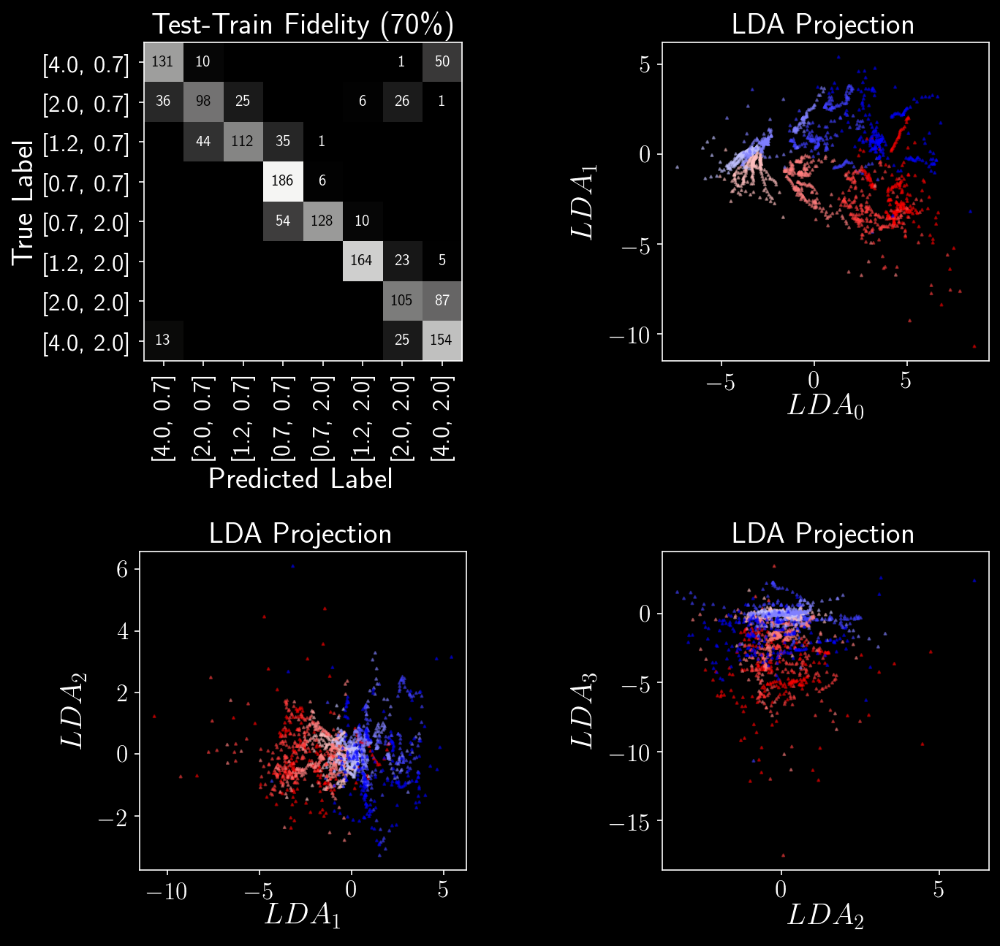

In [25]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 3
train2 = 8

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [26]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fmor16,S0_on = 1, S1_on = 1, S20_on = 1,S12_on = 0)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[117  31   1   0   0   0  40   3]
 [ 18 113  33   0   9  18   1   0]
 [  0  24 146  20   1   1   0   0]
 [  0   0   4 128  60   0   0   0]
 [  0   0   0  20 165   7   0   0]
 [  0   1   6   3   1 169  10   2]
 [  2   1   0   0   0  18 130  41]
 [  7   0   0   0   0   1  79 105]]
Accuracy0.6985677083333334


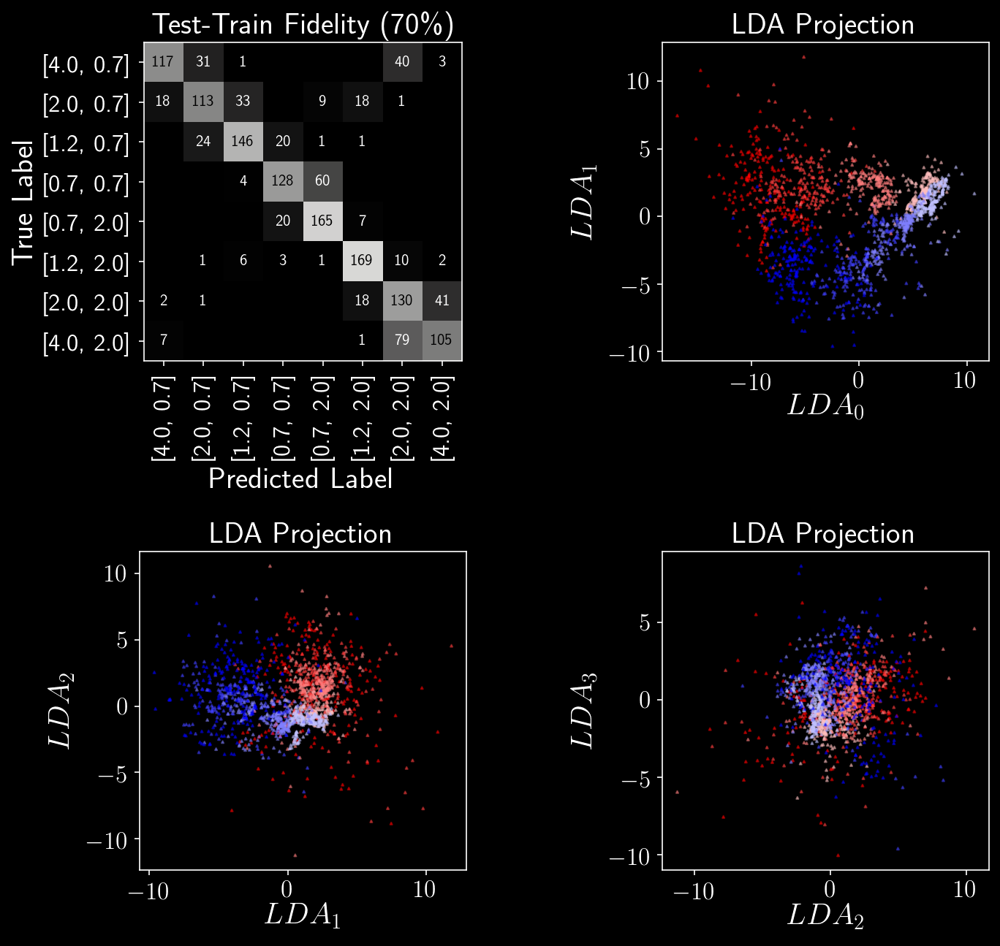

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[ 33  21   0   0   0   5  66  67]
 [ 26  77  38   0   1  34  15   1]
 [  3  29  34   3 117   5   0   1]
 [  0   0   1  58 133   0   0   0]
 [  0   1   2  26 145  17   1   0]
 [  0   1   5   0   3 150  30   3]
 [  1   1   0   0   0   5  98  87]
 [  0   0   0   0   0   0  61 131]]
Accuracy0.47265625


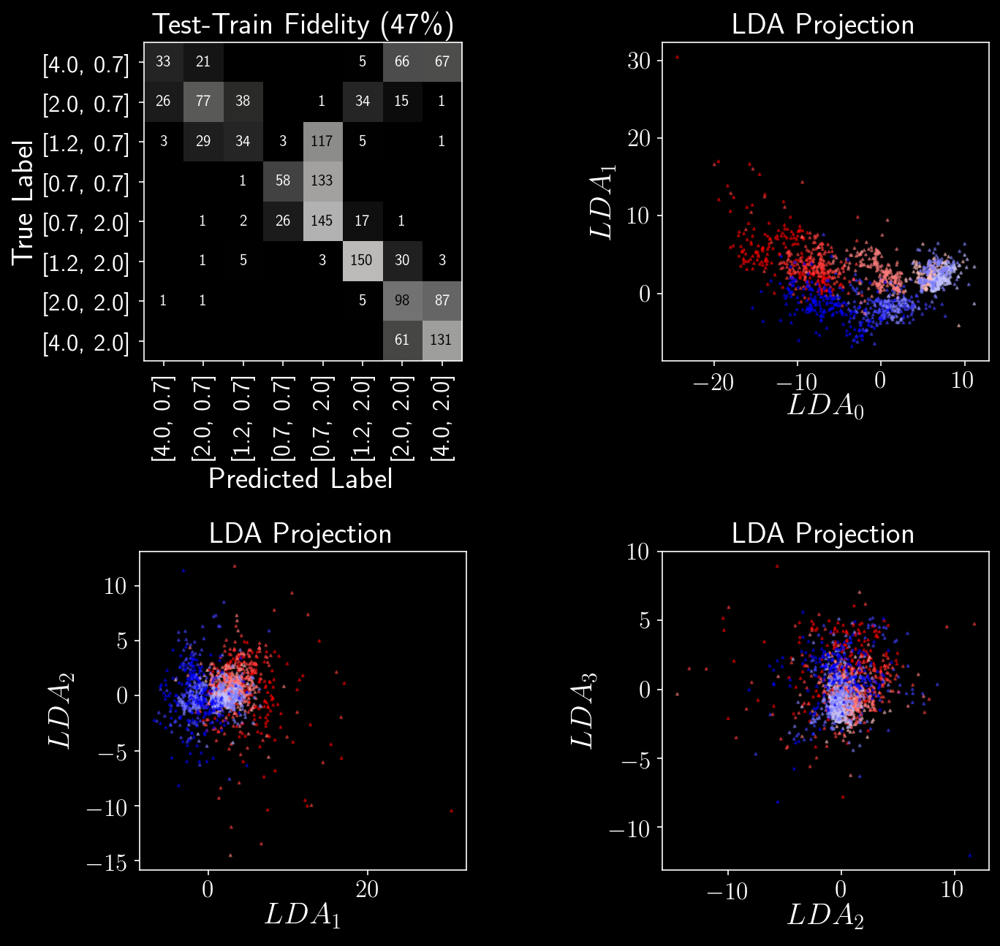

In [27]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 3
train2 = 8

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[132  42   5   0   0   1  12   0]
 [ 24 112  49   0   0   6   1   0]
 [  0  18 114  52   8   0   0   0]
 [  0   0   2 144  46   0   0   0]
 [  0   0   0  36 154   2   0   0]
 [  0  19   2   0   1 162   7   1]
 [  7   2   0   0   0  22 144  17]
 [  8   1   3   0   1   8 109  62]]
Accuracy0.6666666666666666


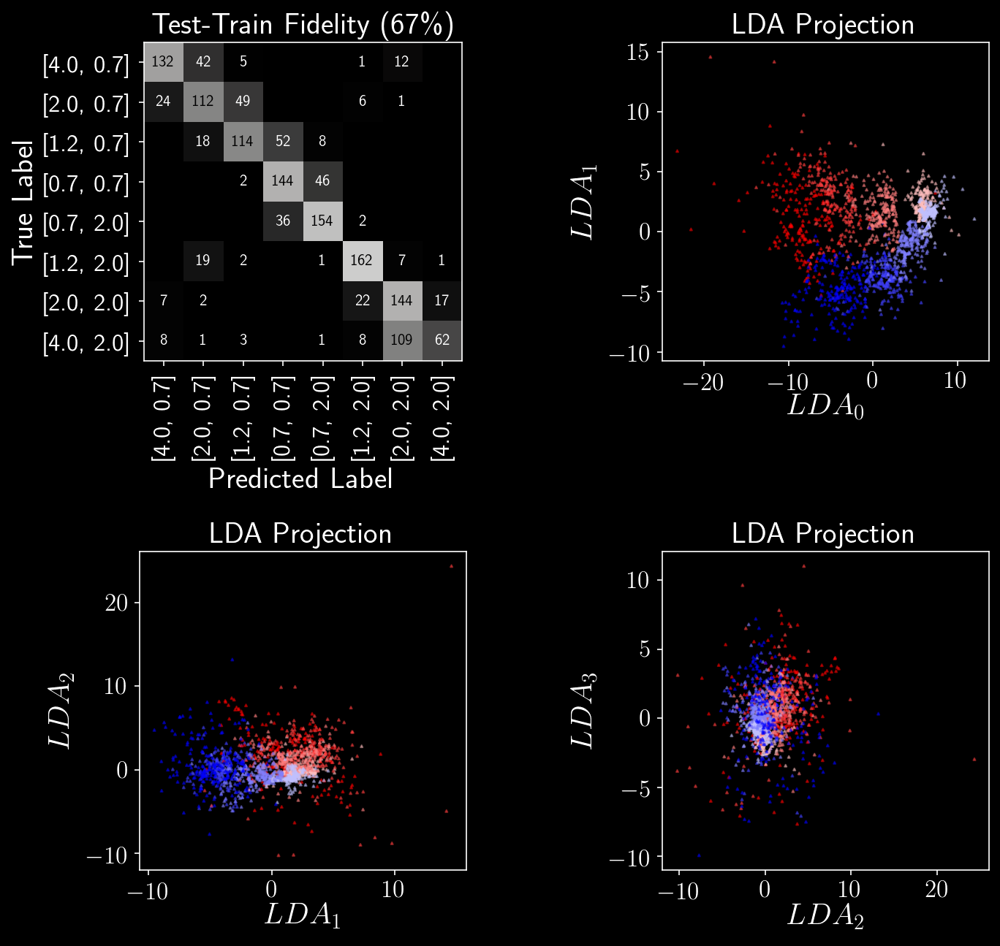

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[ 65  21   8   0   0   8  70  20]
 [  9  73  59   0   0  48   2   1]
 [  0  12  58   7  81  34   0   0]
 [  0   0   0  70 122   0   0   0]
 [  0   0   0  52 134   4   2   0]
 [  0   0   0   1   0 135  54   2]
 [  0   0   0   0   0   0  83 109]
 [  0   0   0   0   0   0  27 165]]
Accuracy0.509765625


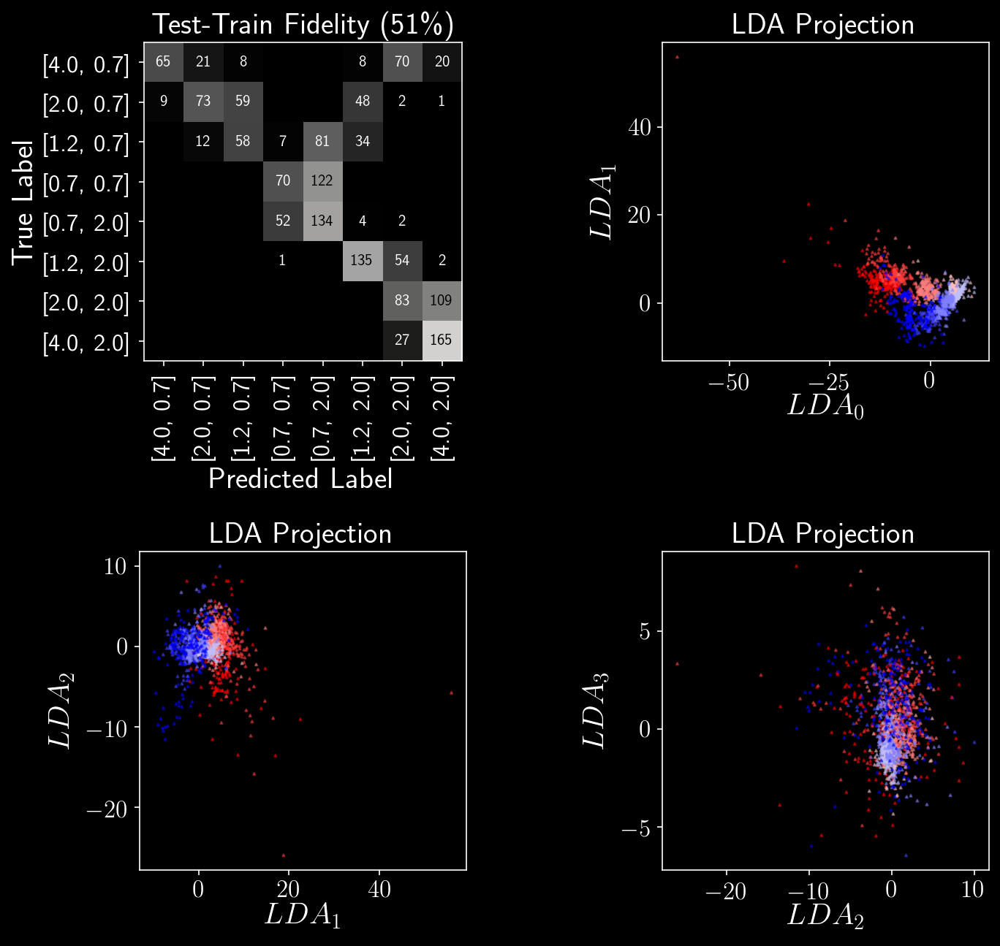

In [28]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [29]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fmor16,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 1)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[132  42   5   0   0   1  12   0]
 [ 24 112  49   0   0   6   1   0]
 [  0  18 114  52   8   0   0   0]
 [  0   0   2 144  46   0   0   0]
 [  0   0   0  36 154   2   0   0]
 [  0  19   2   0   1 162   7   1]
 [  7   2   0   0   0  22 144  17]
 [  8   1   3   0   1   8 109  62]]
Accuracy0.6666666666666666


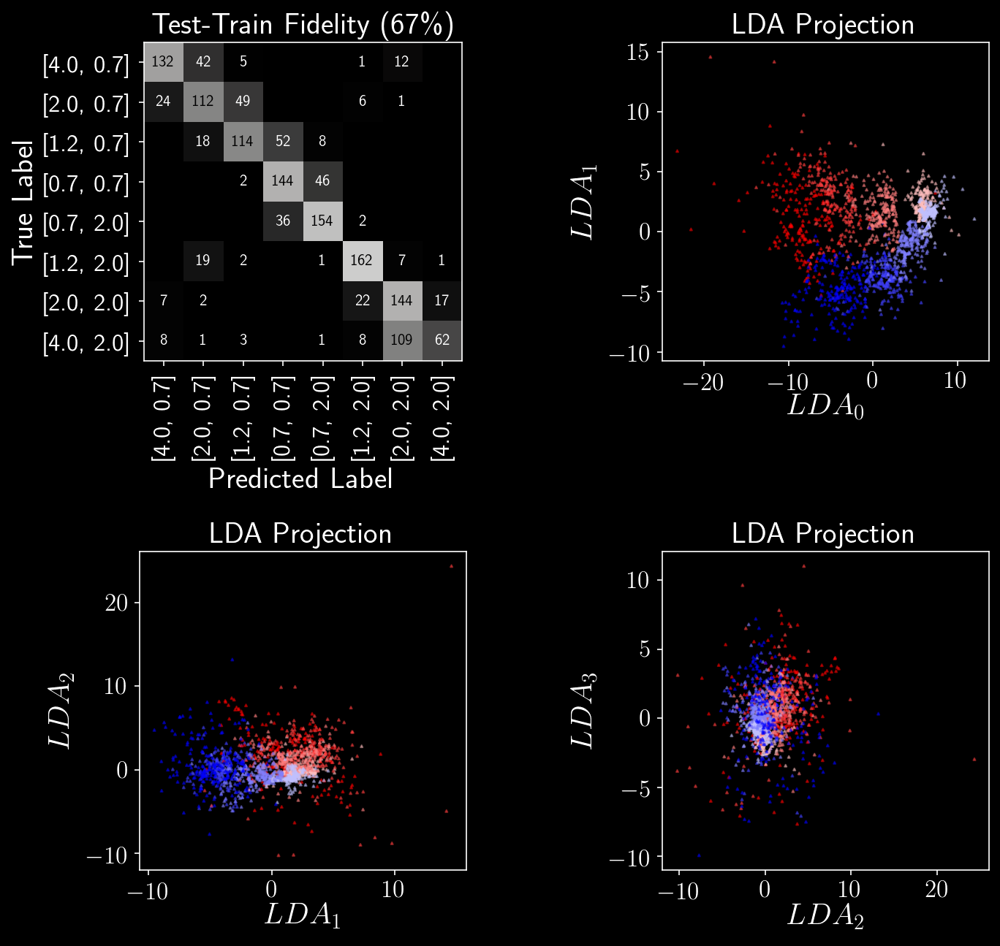

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[ 65  21   8   0   0   8  70  20]
 [  9  73  59   0   0  48   2   1]
 [  0  12  58   7  81  34   0   0]
 [  0   0   0  70 122   0   0   0]
 [  0   0   0  52 134   4   2   0]
 [  0   0   0   1   0 135  54   2]
 [  0   0   0   0   0   0  83 109]
 [  0   0   0   0   0   0  27 165]]
Accuracy0.509765625


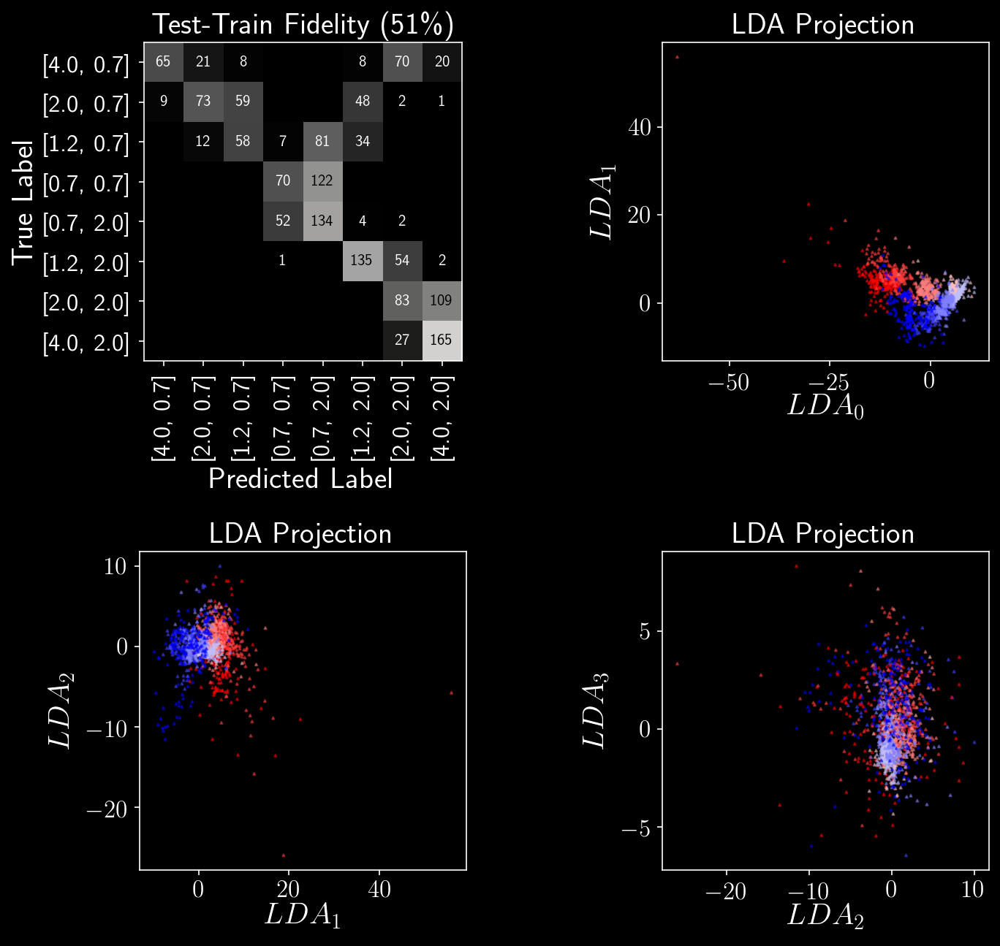

In [30]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [31]:
with open('FromCannon/2020_11_23/DHC_MHD_rinvar_fink.p', 'rb') as input_file:
    DHC_MHD_rinvar_fink = np.array(pickle.load(input_file))

In [32]:
def DHC_reader_iso(data,S0_on = 1,S1_on = 1, S20_on = 1, S12_on = 1):
    L = 8
    data = np.array(data)
    data0 = np.array([data[i,0].flatten() for i in range(13824)])
    
    data1_raw = np.array([data[i,1] for i in range(13824)])
    data1_iso = np.array([np.sum(data1_raw[i,:,:],axis=1) for i in range(13824)])
    data1 = np.array([data1_iso[i,:].flatten() for i in range(13824)])
    
    data2_raw = np.array([data[i,2] for i in range(13824)])
    data2_iso = [np.sum([data2_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data2_iso = np.moveaxis(np.array(data2_iso), 0, -1)
    
    data2 = np.array([data2_iso[i,:,:,:].flatten() for i in range(13824)])
    
    data3_raw = np.array([data[i,2] for i in range(13824)])
    data3_iso = [np.sum([data3_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data3_iso = np.moveaxis(np.array(data3_iso), 0, -1)
    
    data3 = np.array([data3_iso[i,:,:,:].flatten() for i in range(13824)])
    
    if np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data1,data3))
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1))
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2))
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 1]):
        out = data1
        
    elif np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 0]):
        out = np.hstack((data0,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 0]):
        out = data3
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 0]):
        out = data0
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 0]):
        out = data2
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 0]):
        out = np.hstack(([]))
        
    return out

In [33]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)

[[159  18   0   0   0   0   5  10]
 [ 21 164   3   0   0   0   3   1]
 [  0  17 172   0   0   3   0   0]
 [  0   0   0 184   8   0   0   0]
 [  0   0   0   6 184   2   0   0]
 [  0   0   0   0   0 182  10   0]
 [  1   1   0   0   0   0 181   9]
 [ 12   0   0   0   0   0  19 161]]
Accuracy0.9029947916666666


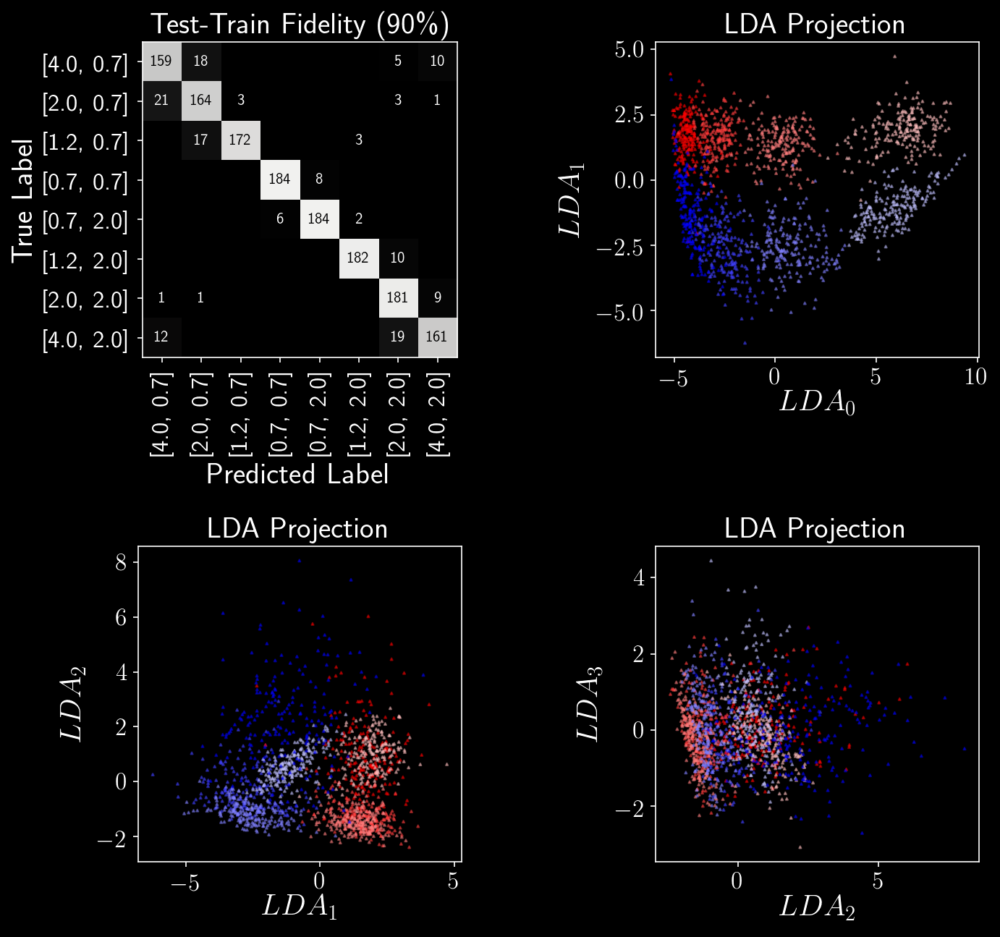

[[155  17   0   0   0   0   6  14]
 [ 23 158   3   0   0   0   6   2]
 [  0  17 171   0   0   4   0   0]
 [  0   0   0 182  10   0   0   0]
 [  0   0   0   6 184   2   0   0]
 [  0   0   0   0   0 179  13   0]
 [  0   0   0   0   0   0 182  10]
 [  9   0   0   0   0   0  20 163]]
Accuracy0.89453125


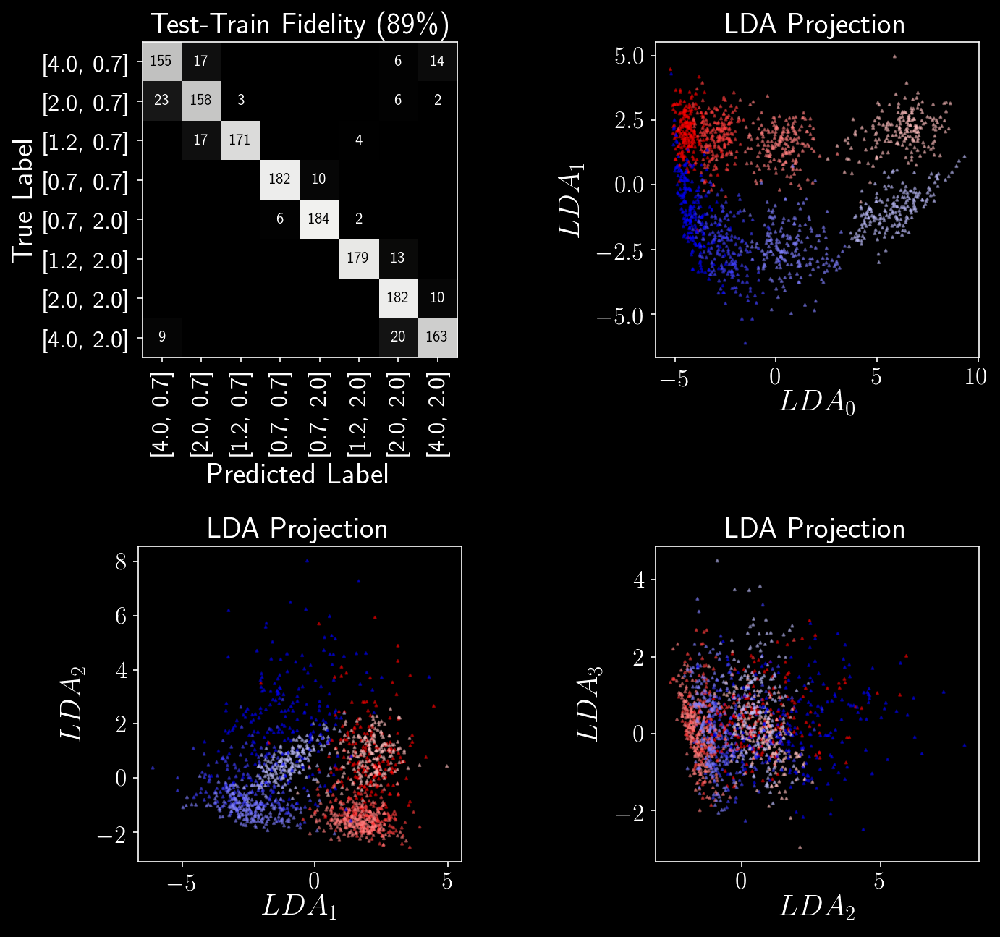

In [34]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==6,
                np.remainder(ele[0],9)==2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=6,
                 np.remainder(ele[0],9)!=2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==6,
                np.remainder(ele[0],9)==2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=6,
                 np.remainder(ele[0],9)!=2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

[[138  15   0   0   0   0   3  36]
 [ 11 156  10   0   0   1  12   2]
 [  0  17 155   8   0  12   0   0]
 [  0   0  10 176   5   1   0   0]
 [  0   0   0  12 180   0   0   0]
 [  0   2   3   0   1 172  14   0]
 [  1   3   0   0   0   4 173  11]
 [ 17   0   0   0   0   0  20 155]]
Accuracy0.849609375


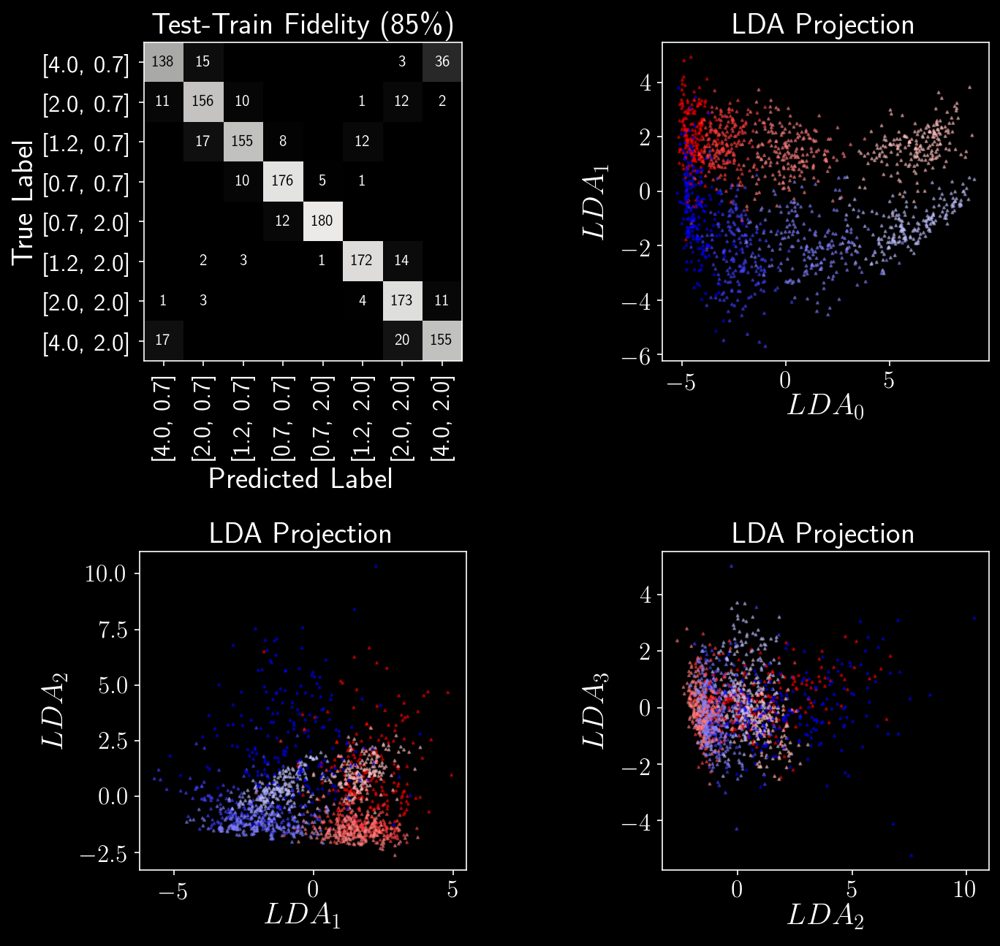

[[129  11   0   0   0   0   5  47]
 [ 12 150  10   0   0   1  17   2]
 [  0  16 148   8   0  20   0   0]
 [  0   0   9 175   5   3   0   0]
 [  0   0   0  12 180   0   0   0]
 [  0   0   0   0   1 172  19   0]
 [  1   3   0   0   0   4 173  11]
 [ 12   0   0   0   0   0  19 161]]
Accuracy0.8385416666666666


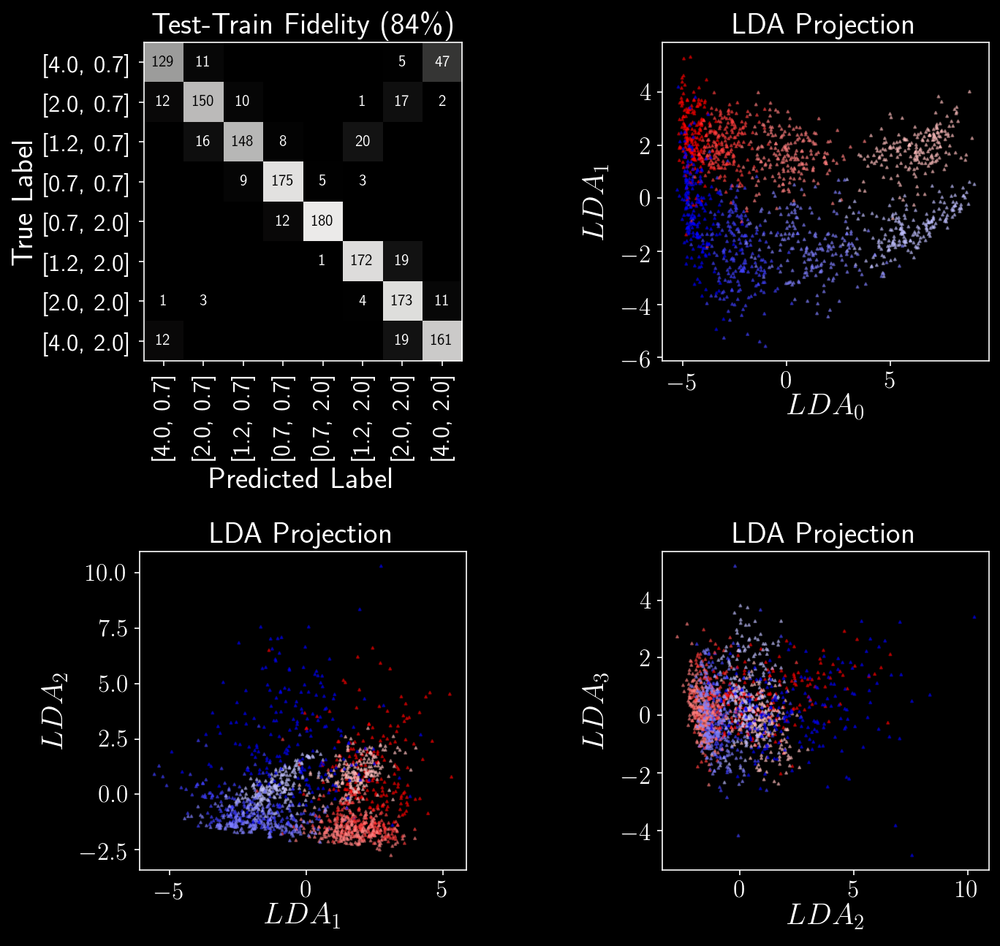

In [35]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 7
train2 = 1

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [36]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 0, S1_on = 1, S20_on = 0,S12_on = 0)

[[157  20   0   0   0   0   5  10]
 [ 23 162   3   0   0   0   3   1]
 [  0  16 173   0   0   3   0   0]
 [  0   0   0 185   7   0   0   0]
 [  0   0   0   6 184   2   0   0]
 [  0   0   1   0   0 181  10   0]
 [  0   0   0   0   0   0 184   8]
 [ 16   0   0   0   0   0  20 156]]
Accuracy0.8997395833333334


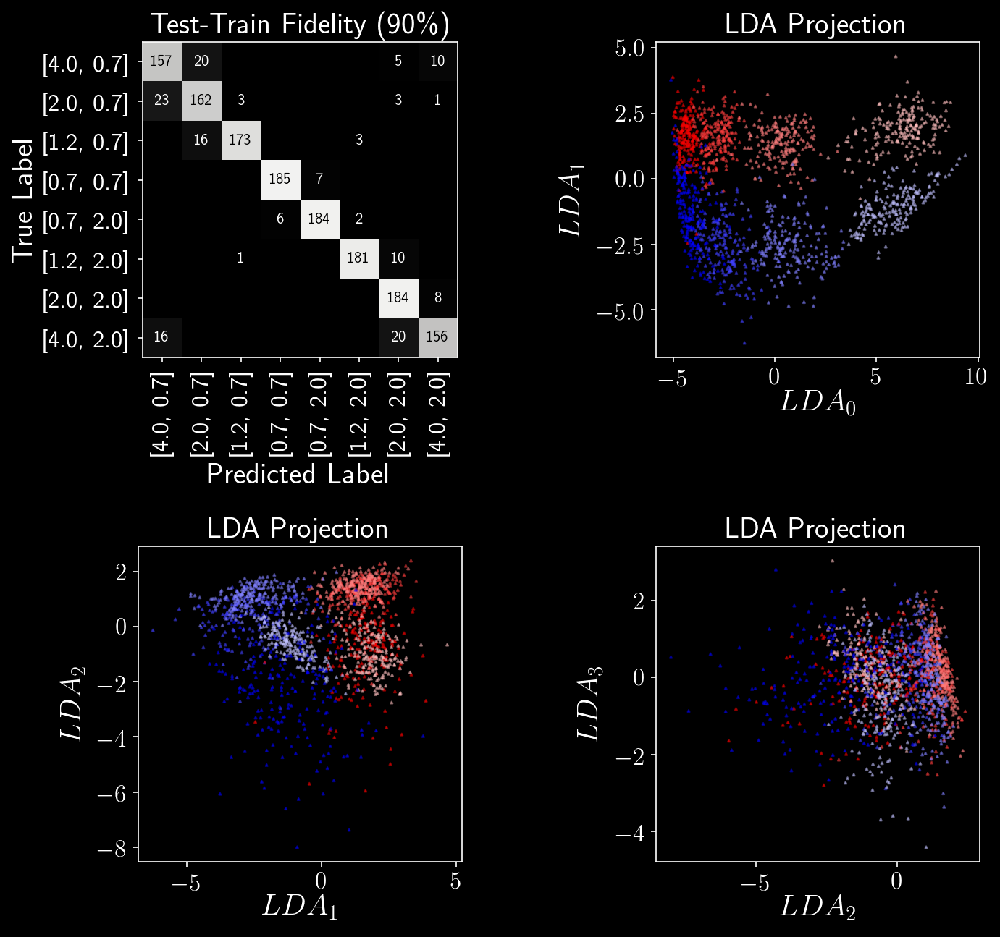

[[152  19   0   0   0   0   6  15]
 [ 25 155   3   0   0   0   8   1]
 [  0  16 172   0   0   4   0   0]
 [  0   0   0 181  11   0   0   0]
 [  0   0   0   6 184   2   0   0]
 [  0   0   0   0   0 179  13   0]
 [  0   0   0   0   0   0 184   8]
 [  9   0   0   0   0   0  20 163]]
Accuracy0.8919270833333334


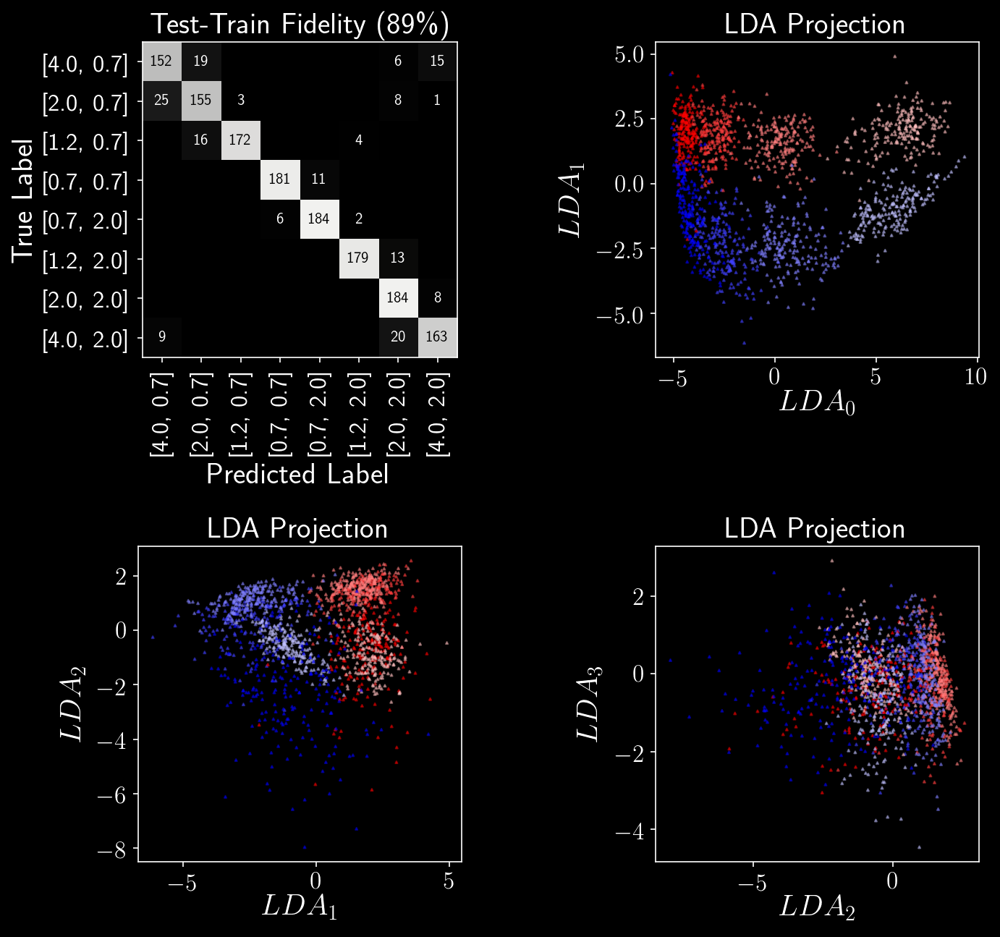

In [37]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [38]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 0, S1_on = 0, S20_on = 0,S12_on = 1)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[182   7   0   0   0   0   0   3]
 [ 11 181   0   0   0   0   0   0]
 [  0   5 187   0   0   0   0   0]
 [  0   0   0 190   2   0   0   0]
 [  0   0   0   0 192   0   0   0]
 [  0   0   0   0   0 190   2   0]
 [  0   0   0   0   0   2 175  15]
 [  0   0   0   0   0   0   5 187]]
Accuracy0.9661458333333334


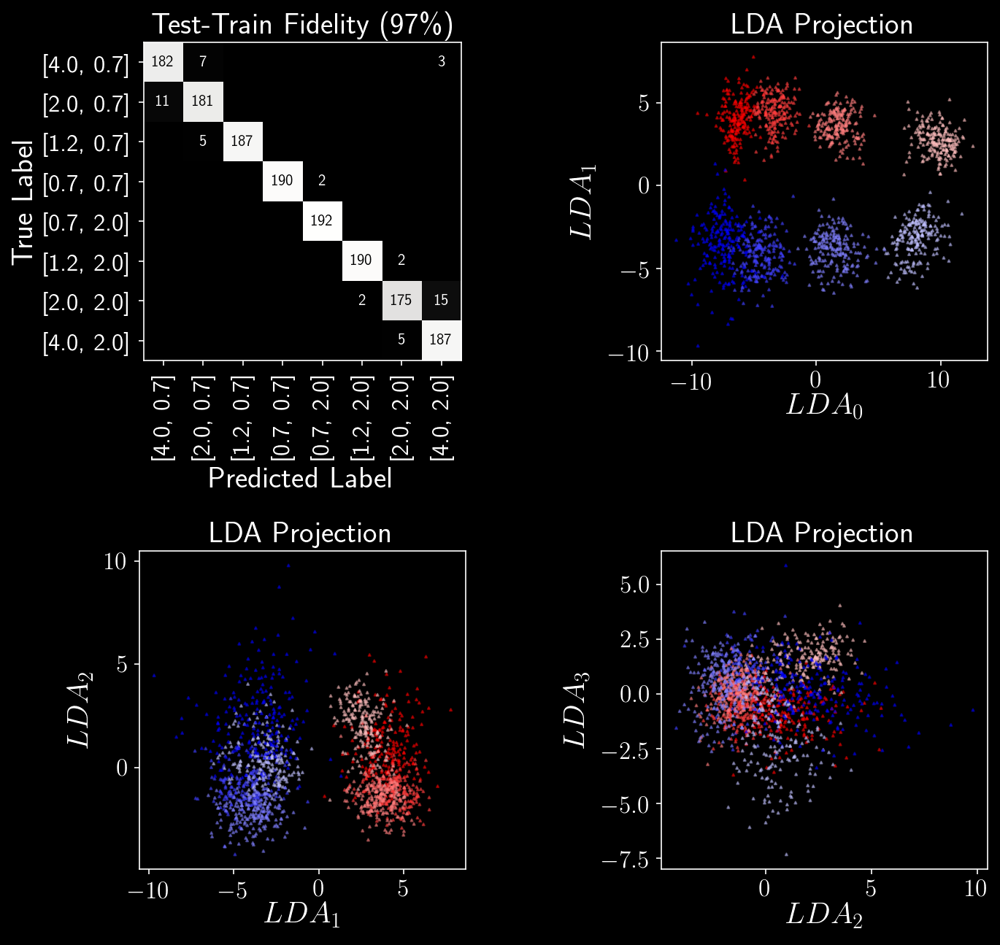

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[170  13   0   0   0   0   1   8]
 [ 11 180   1   0   0   0   0   0]
 [  0   7 185   0   0   0   0   0]
 [  0   0   0 185   7   0   0   0]
 [  0   0   0   0 191   1   0   0]
 [  0   0   0   0   0 191   1   0]
 [  0   0   0   0   0   0 174  18]
 [  0   0   0   0   0   0   9 183]]
Accuracy0.9498697916666666


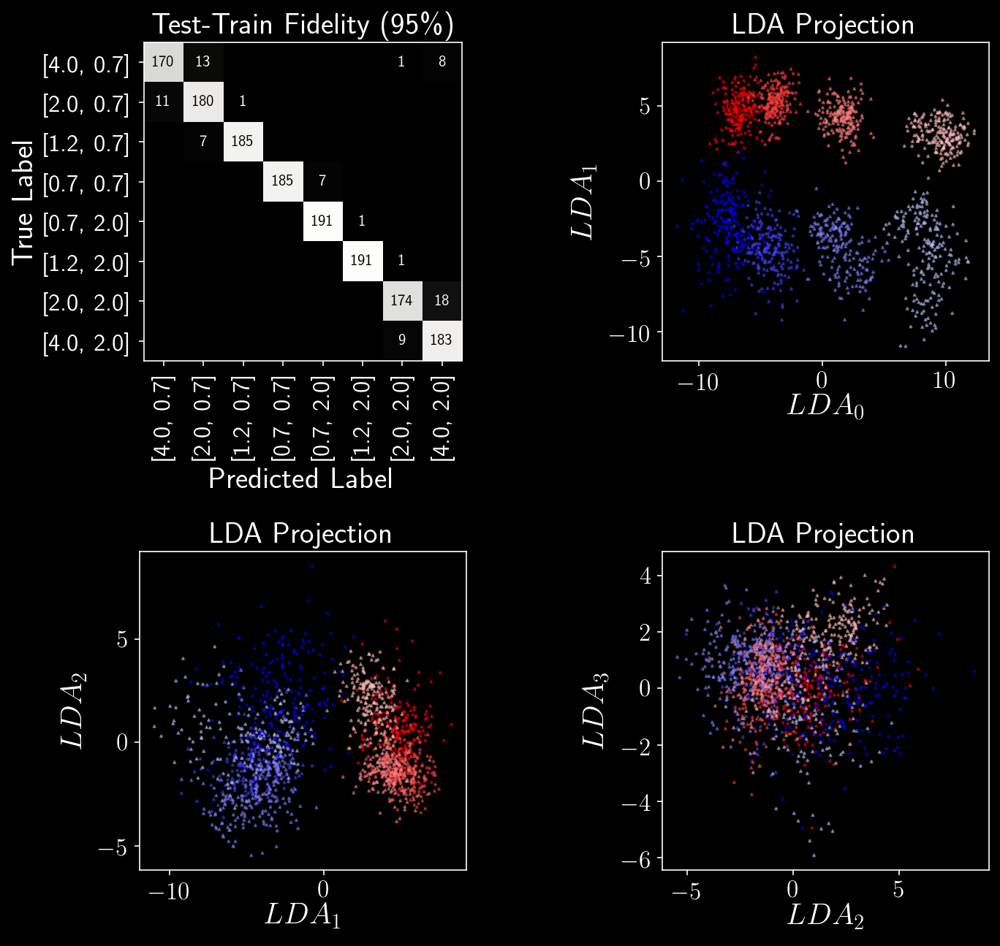

In [39]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [40]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 0, S1_on = 0, S20_on = 1,S12_on = 0)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[182   7   0   0   0   0   0   3]
 [ 11 181   0   0   0   0   0   0]
 [  0   5 187   0   0   0   0   0]
 [  0   0   0 190   2   0   0   0]
 [  0   0   0   0 192   0   0   0]
 [  0   0   0   0   0 190   2   0]
 [  0   0   0   0   0   2 175  15]
 [  0   0   0   0   0   0   5 187]]
Accuracy0.9661458333333334


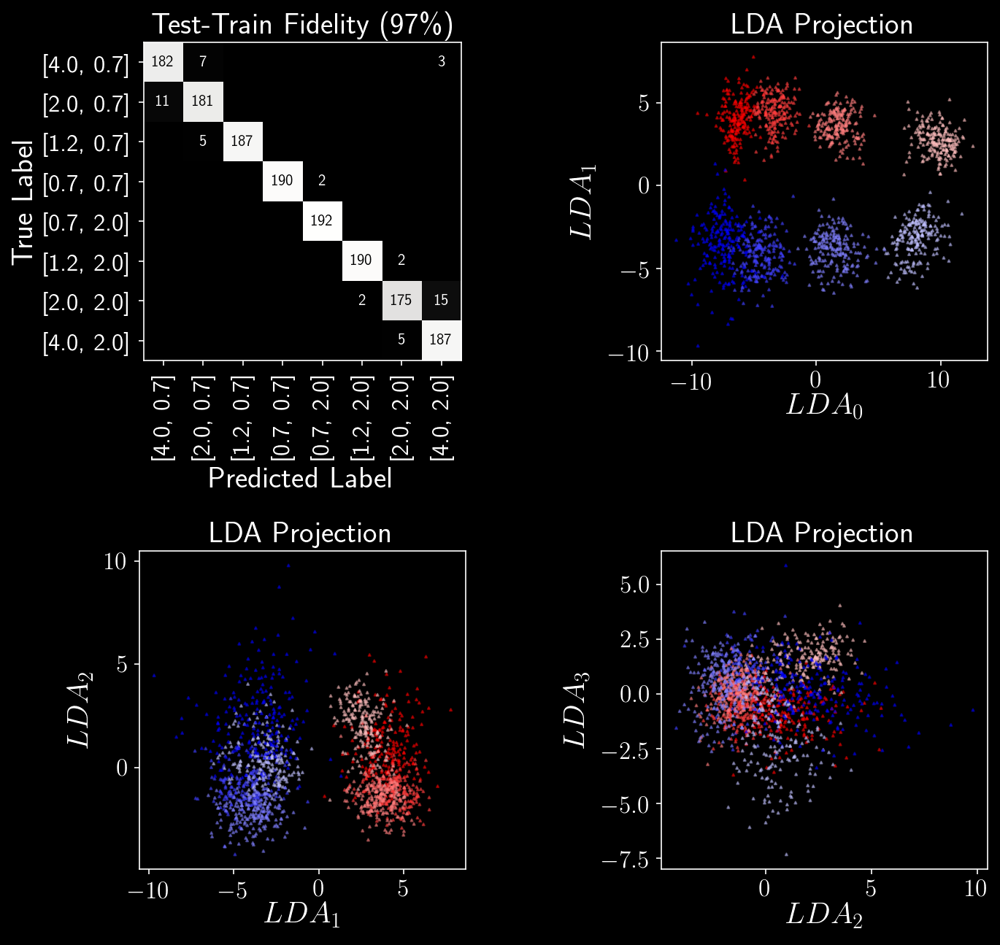

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[170  13   0   0   0   0   1   8]
 [ 11 180   1   0   0   0   0   0]
 [  0   7 185   0   0   0   0   0]
 [  0   0   0 185   7   0   0   0]
 [  0   0   0   0 191   1   0   0]
 [  0   0   0   0   0 191   1   0]
 [  0   0   0   0   0   0 174  18]
 [  0   0   0   0   0   0   9 183]]
Accuracy0.9498697916666666


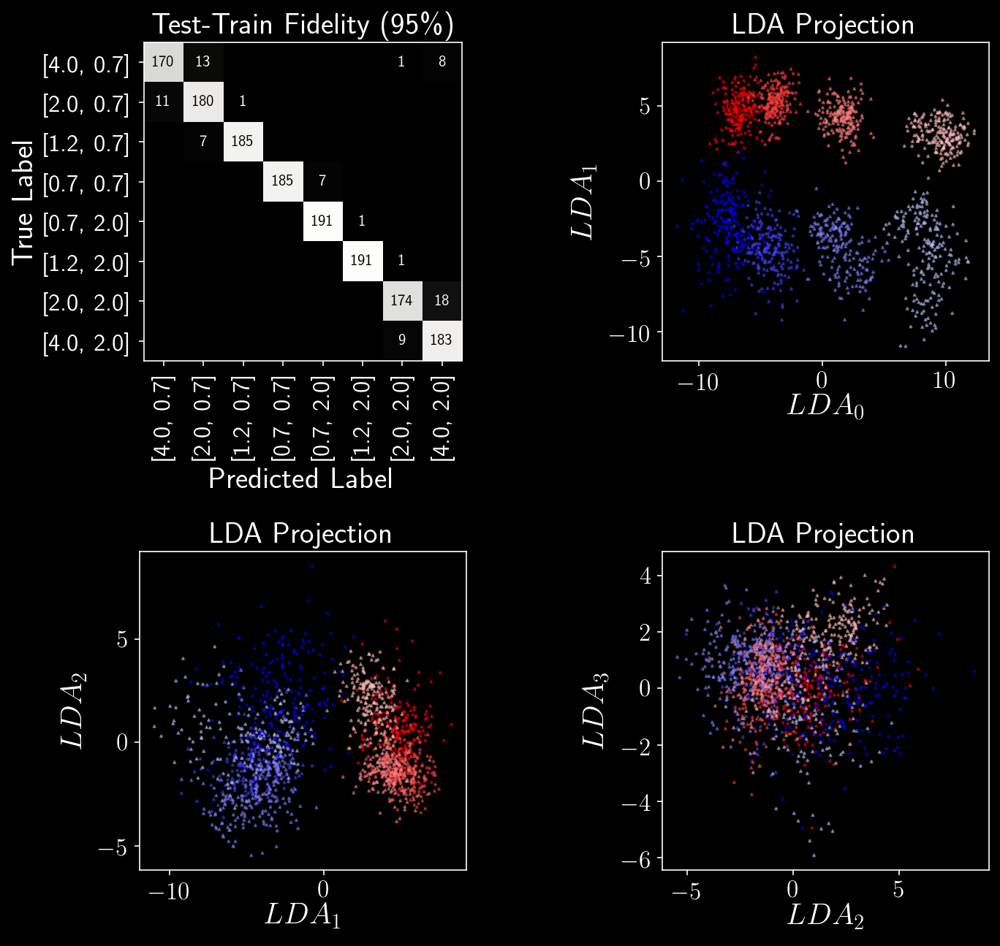

In [41]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [42]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 1, S1_on = 1, S20_on = 1,S12_on = 1)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[182   9   0   0   0   0   0   1]
 [ 15 177   0   0   0   0   0   0]
 [  0   4 188   0   0   0   0   0]
 [  0   0   0 191   1   0   0   0]
 [  0   0   0   0 192   0   0   0]
 [  0   0   0   0   0 190   2   0]
 [  0   0   0   0   0   1 178  13]
 [  0   0   0   0   0   0   8 184]]
Accuracy0.96484375


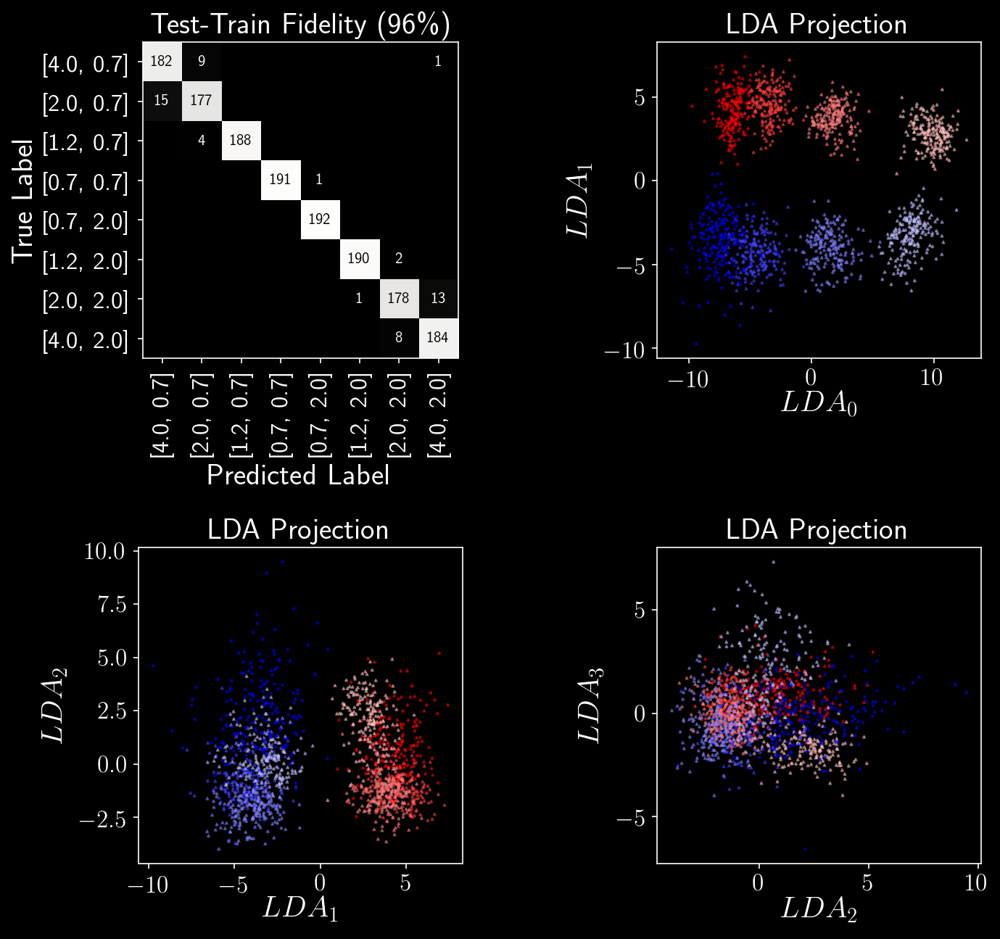

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[172  12   0   0   0   0   0   8]
 [ 10 181   1   0   0   0   0   0]
 [  0   7 185   0   0   0   0   0]
 [  0   0   0 186   6   0   0   0]
 [  0   0   0   0 191   1   0   0]
 [  0   0   0   0   0 191   1   0]
 [  0   0   0   0   0   0 174  18]
 [  0   0   0   0   0   0   9 183]]
Accuracy0.9524739583333334


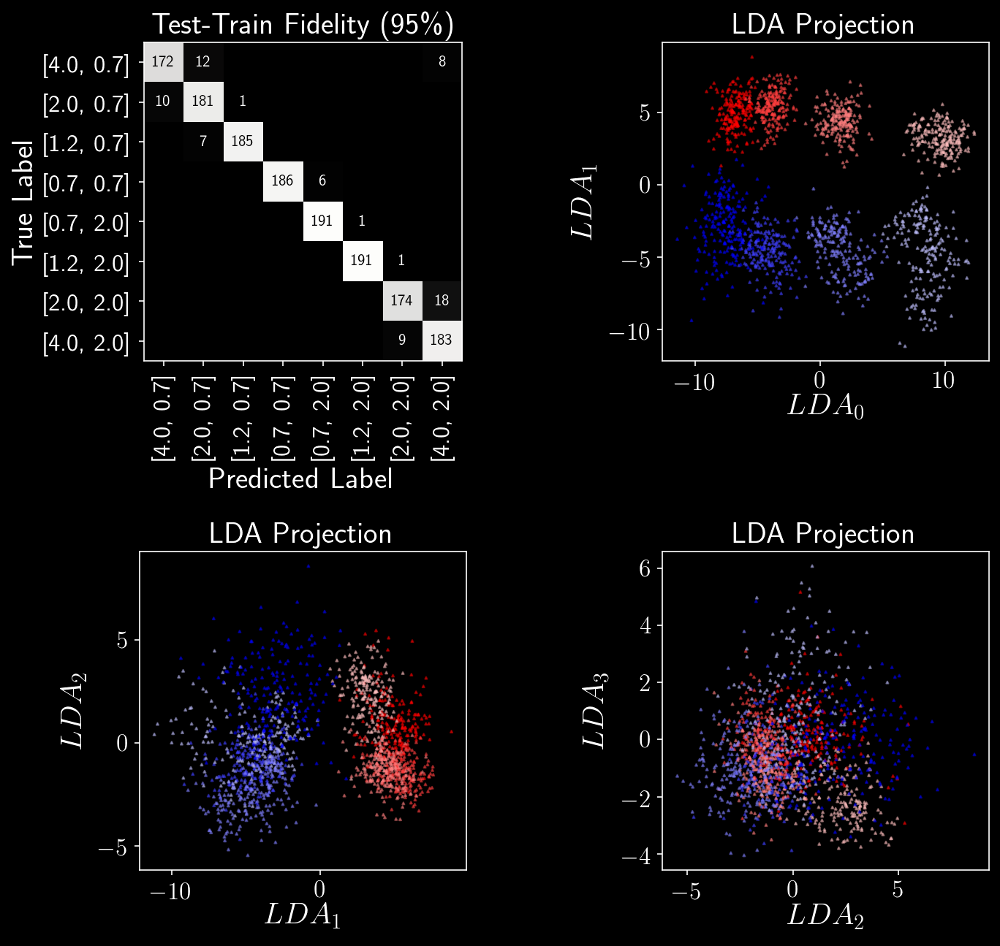

In [43]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [44]:
with open('FromCannon/2020_11_23/DHC_MHD_rinvar_cumsum_fink.p', 'rb') as input_file:
    DHC_MHD_rinvar_cumsum_fink = np.array(pickle.load(input_file))

In [45]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fink,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)

[[173   8   0   0   0   0   1  10]
 [  5 173   7   0   0   0   7   0]
 [  0   3 171  14   0   4   0   0]
 [  0   0  20 147  25   0   0   0]
 [  0   0   0  20 171   1   0   0]
 [  0   0   0   0   0 187   5   0]
 [  5   0   0   0   0   1 164  22]
 [ 15   0   0   0   0   0   1 176]]
Accuracy0.88671875


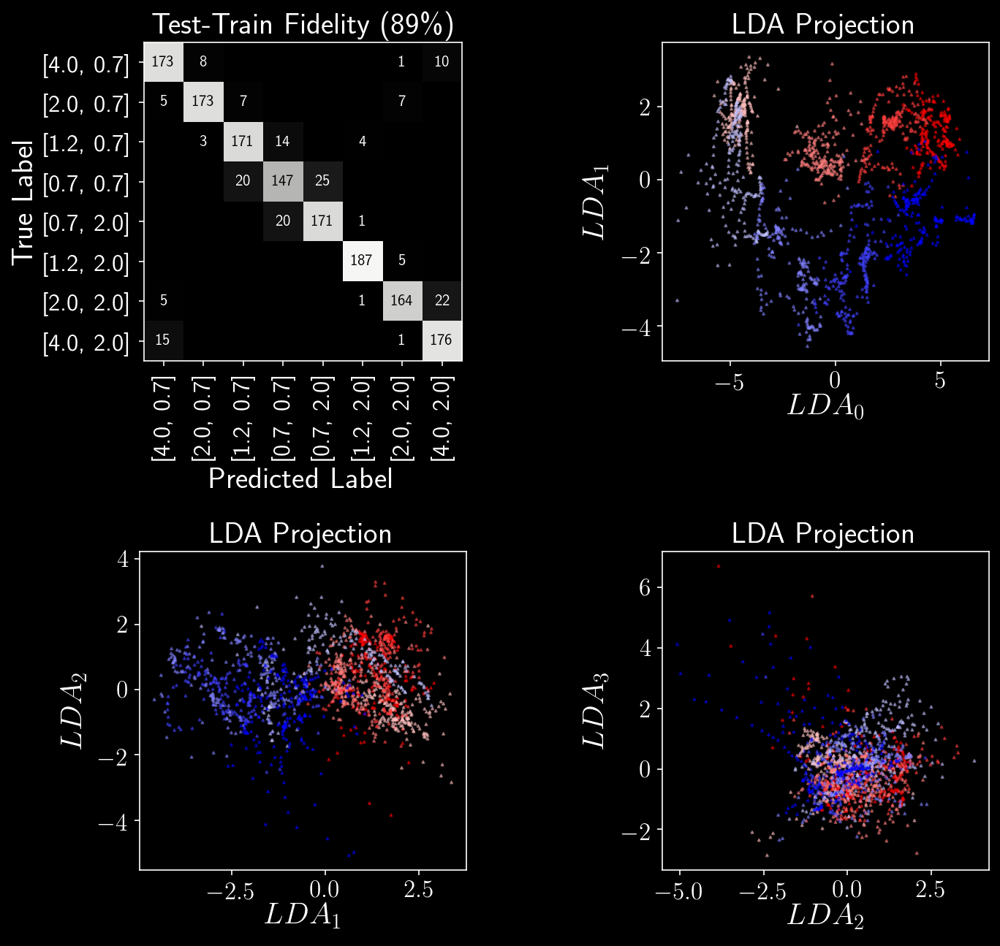

[[171   6   0   0   0   0   1  14]
 [  5 170   7   0   0   0  10   0]
 [  0   3 171  14   0   4   0   0]
 [  0   0  20 146  26   0   0   0]
 [  0   0   0  20 171   1   0   0]
 [  0   0   0   0   0 183   9   0]
 [  4   0   0   0   0   0 161  27]
 [  9   0   0   0   0   0   1 182]]
Accuracy0.8821614583333334


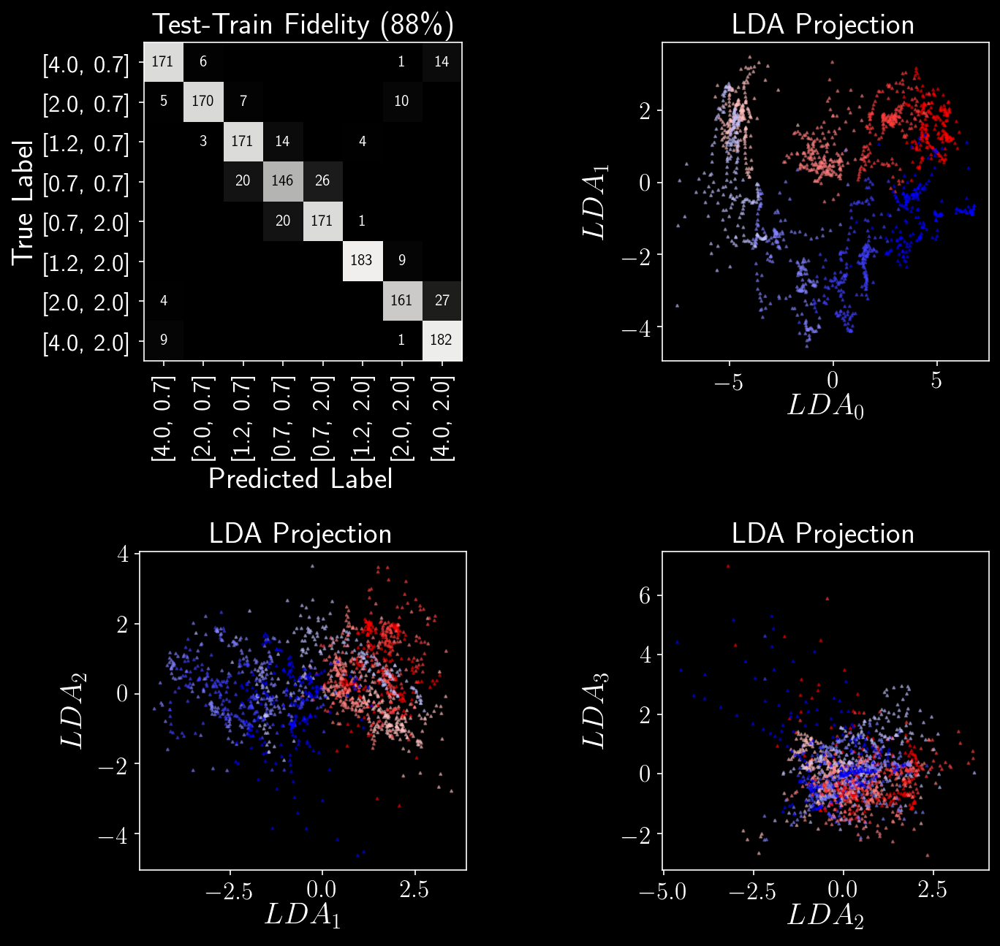

In [46]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

[[110   3   0   0   0   0   8  71]
 [ 13 161  18   0   0   0   0   0]
 [  0   8 155  19   2   8   0   0]
 [  0   0  42  98  49   3   0   0]
 [  0   0   0  12 176   4   0   0]
 [  0   0   2   0   3 145  42   0]
 [  4   8   0   0   0   4 155  21]
 [ 15   0   0   0   0   0  19 158]]
Accuracy0.75390625


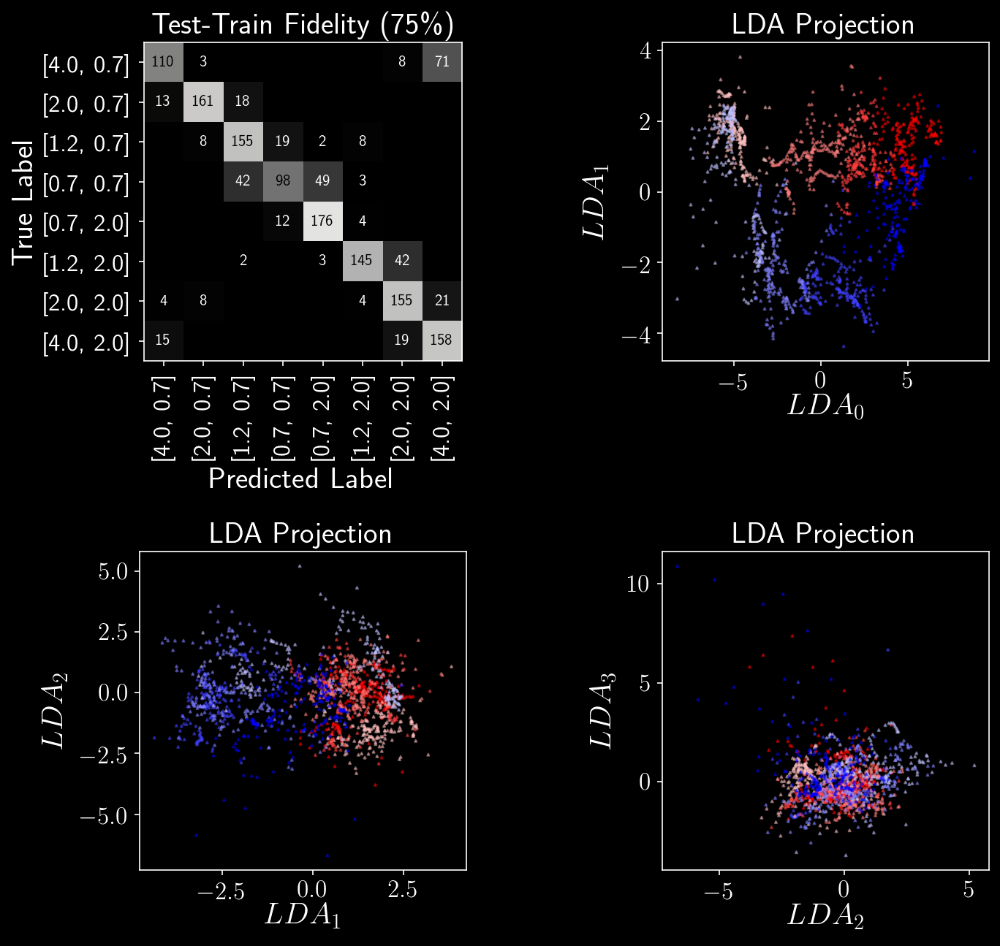

[[ 92   3   0   0   0   0  10  87]
 [ 13 161  17   0   0   0   1   0]
 [  0   8 154  18   2  10   0   0]
 [  0   0  42  98  49   3   0   0]
 [  0   0   0  11 177   4   0   0]
 [  0   0   2   0   2 136  52   0]
 [  0   5   0   0   0   0 155  32]
 [ 11   0   0   0   0   0  17 164]]
Accuracy0.740234375


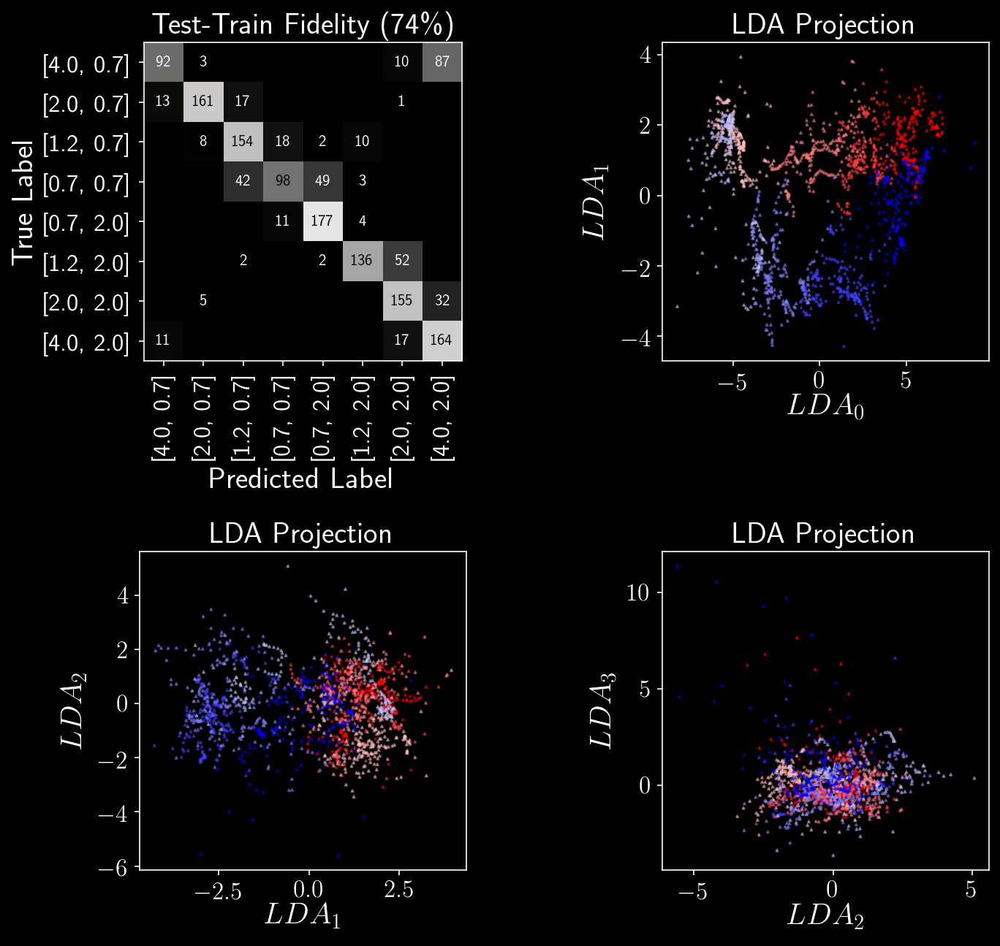

In [47]:
#
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 7
train2 = 1

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

[[154  10   0   0   0   0   2  26]
 [ 15 127  15   0   0   3  32   0]
 [  0  64 116   8   0   4   0   0]
 [  0   0   3 152  37   0   0   0]
 [  0   0   1  51 132   8   0   0]
 [  0   1   0   0   0 167  24   0]
 [  1   0   0   0   0   0 159  32]
 [ 29   0   0   0   0   0  46 117]]
Accuracy0.7317708333333334


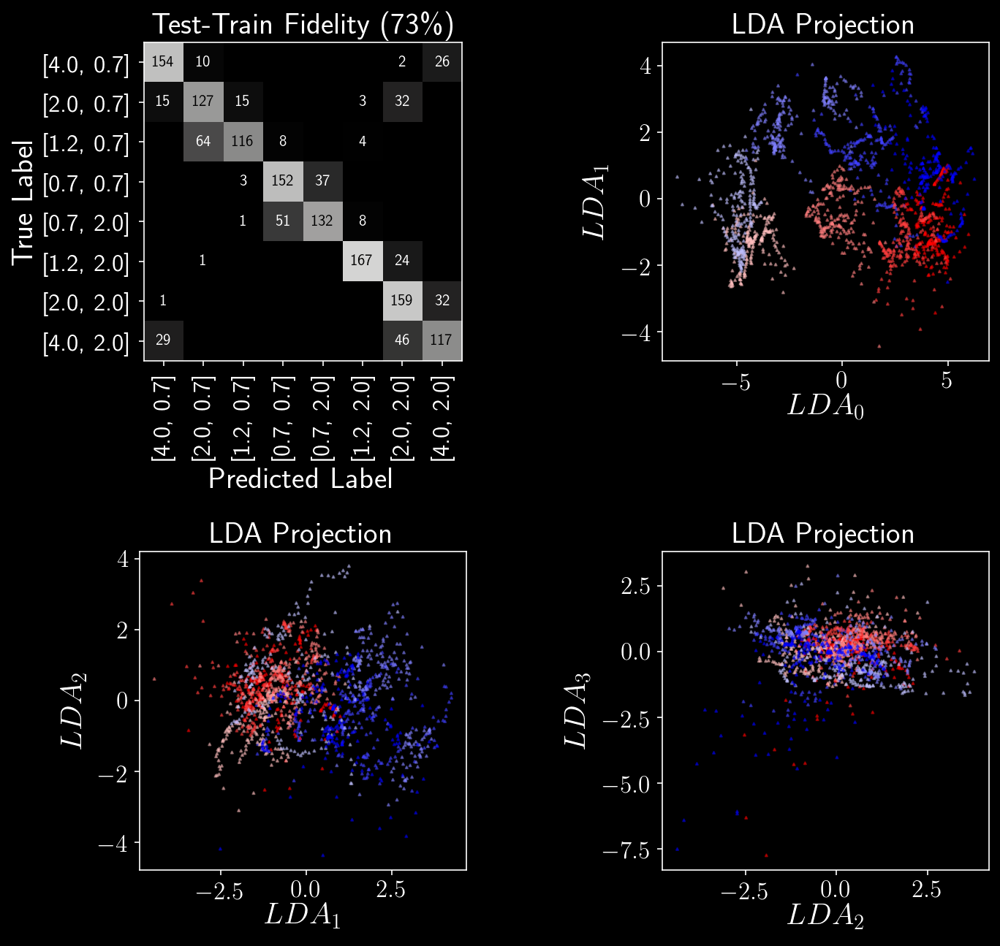

[[143   7   0   0   0   0   2  40]
 [ 25 117  15   0   0   2  33   0]
 [  0  64 118   6   0   4   0   0]
 [  0   0   3 151  38   0   0   0]
 [  0   0   1  49 134   8   0   0]
 [  0   0   0   0   0 165  27   0]
 [  0   0   0   0   0   0 146  46]
 [ 27   0   0   0   0   0  36 129]]
Accuracy0.7180989583333334


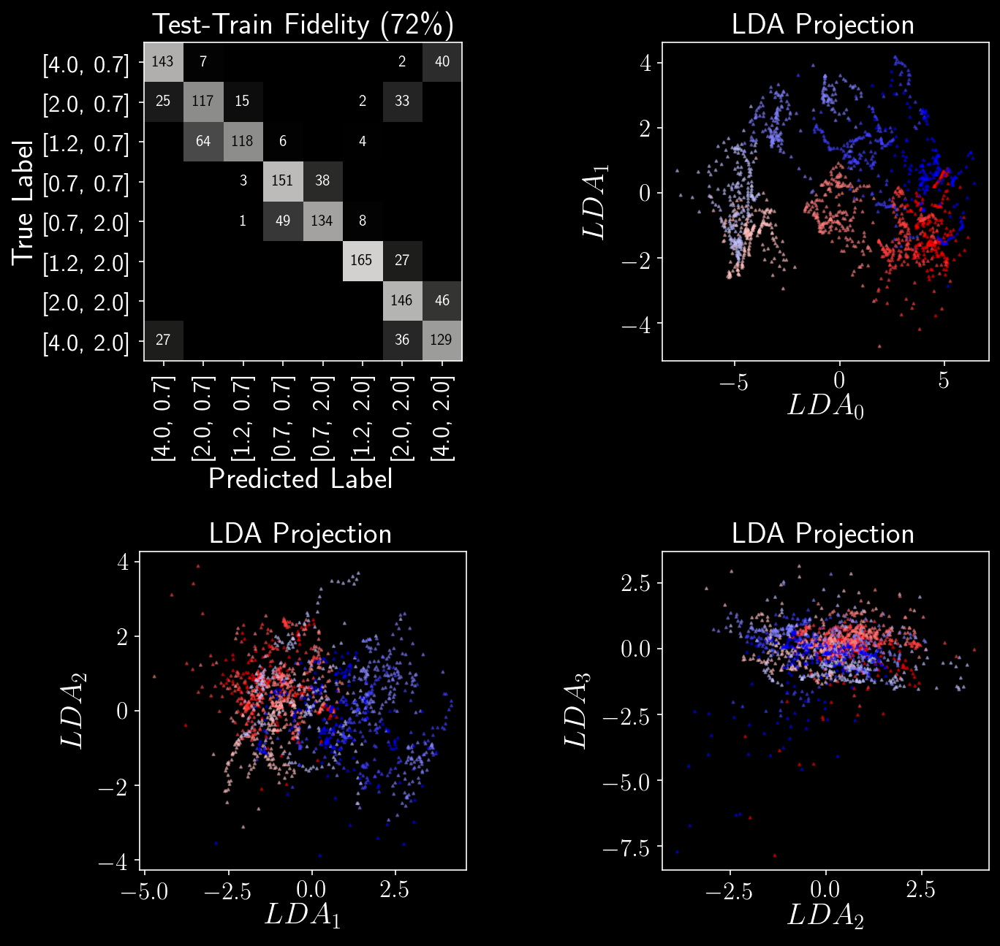

In [48]:
#
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 8
train2 = 3

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [49]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fink,S0_on = 1, S1_on = 1, S20_on = 1,S12_on = 0)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[143  18   0   1   0   1  11  18]
 [ 14 165  13   0   0   0   0   0]
 [  1  12 171   7   0   0   1   0]
 [  0   0   2 186   4   0   0   0]
 [  0   0   0   0 191   1   0   0]
 [  0   0   0   0   0 188   4   0]
 [  4   0   0   0   0   5 177   6]
 [  8   0   0   0   0   0  39 145]]
Accuracy0.8893229166666666


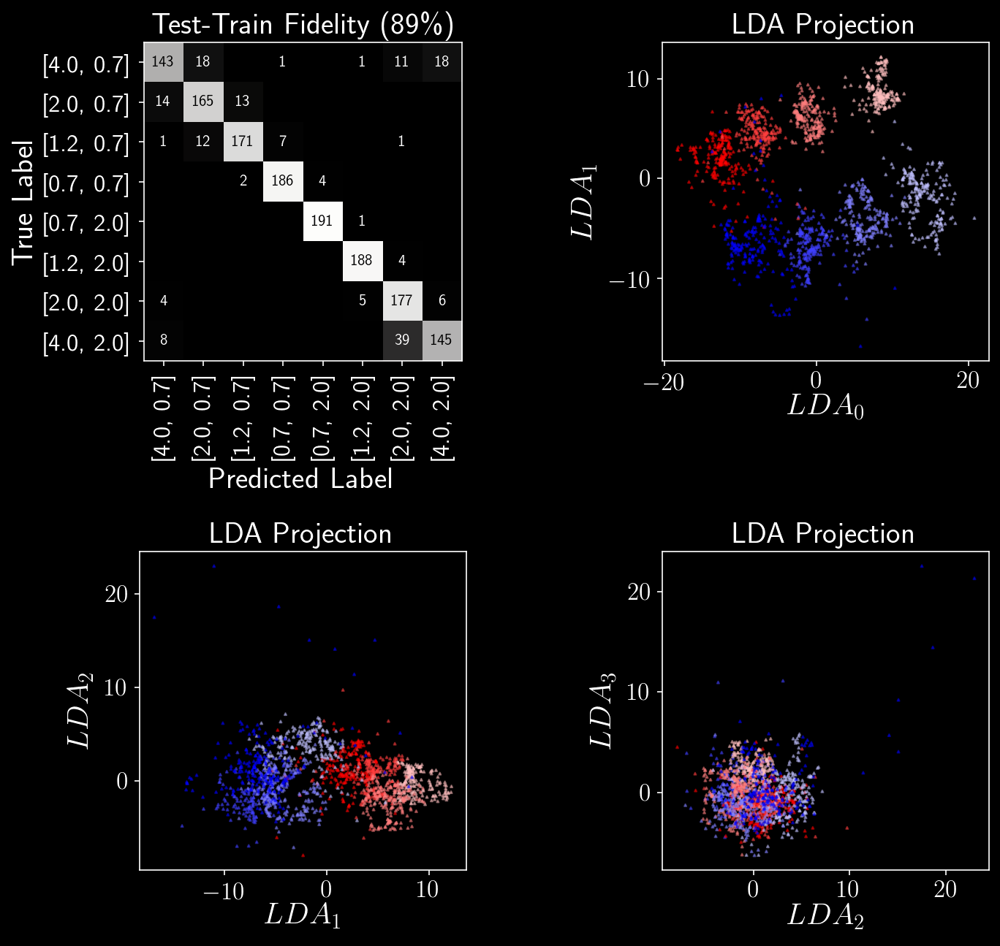

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[149  13   0   0   0   0   6  24]
 [ 16 159  17   0   0   0   0   0]
 [  0  10 135  47   0   0   0   0]
 [  0   0   0 185   7   0   0   0]
 [  0   0   0   0 190   2   0   0]
 [  0   0   0   0   0 179  13   0]
 [  0   0   0   0   0   0 161  31]
 [  3   0   0   0   0   0  18 171]]
Accuracy0.865234375


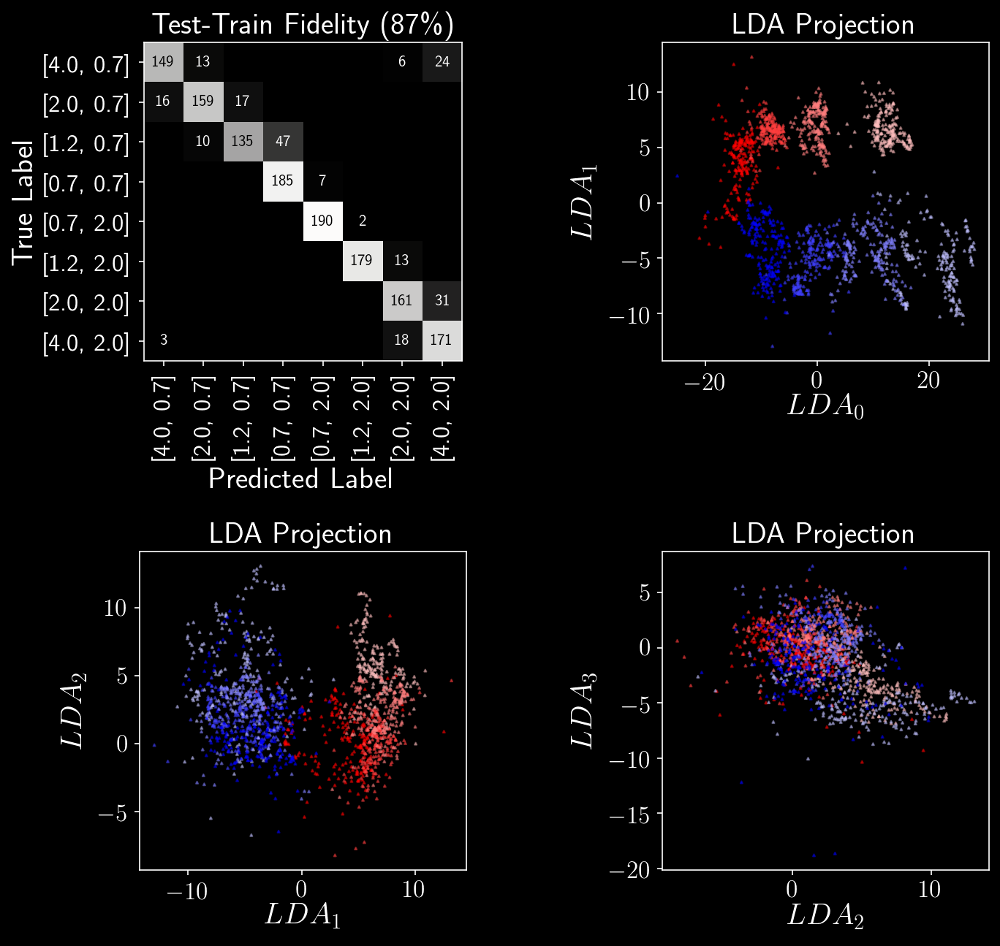

In [50]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[149  23   0   0   0   0   0  20]
 [ 15 162   9   0   0   0   6   0]
 [  0  25 139  27   1   0   0   0]
 [  0   0   2 189   1   0   0   0]
 [  0   0   0   0 192   0   0   0]
 [  0   0   0   0   0 182  10   0]
 [  3   0   0   0   0  13 153  23]
 [ 21   0   0   0   0   0  15 156]]
Accuracy0.8606770833333334


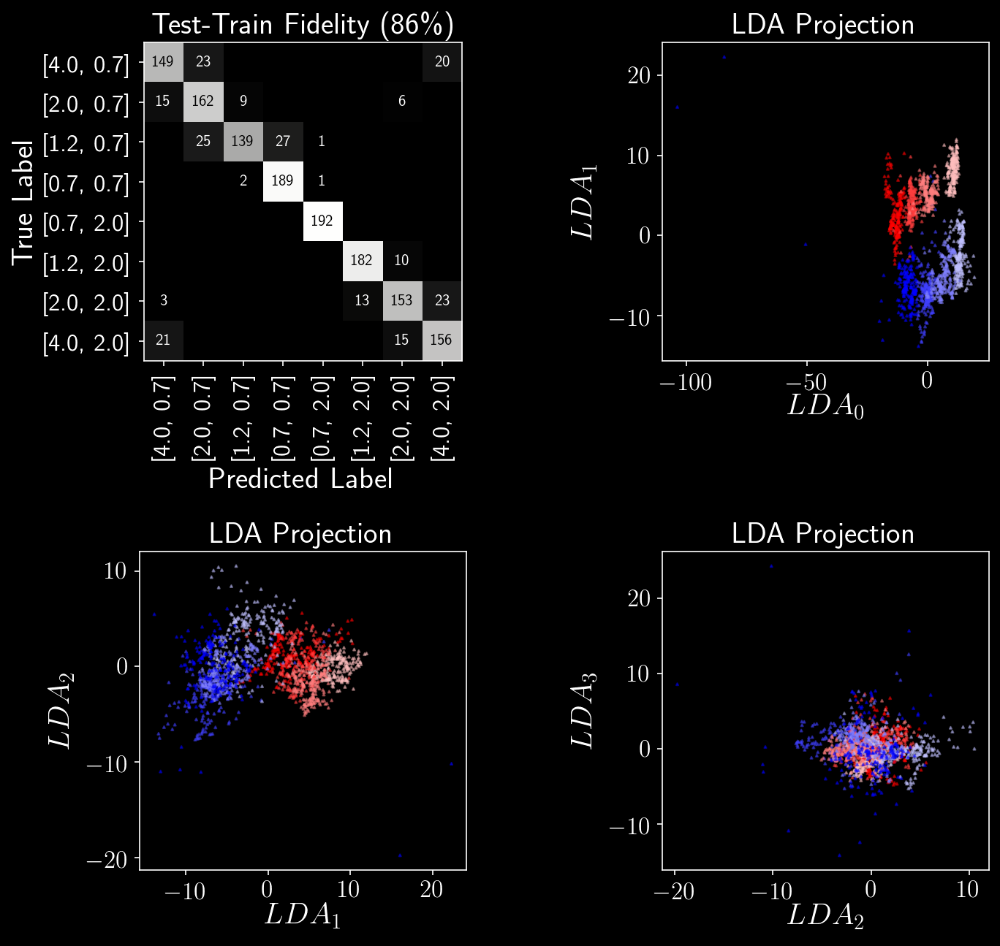

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[115   7   0   0   0   0   8  62]
 [  7 126  55   0   0   0   1   3]
 [  0  10 104  77   0   1   0   0]
 [  0   0  12 174   6   0   0   0]
 [  0   0   0   0 188   4   0   0]
 [  0   0   0   0   0 166  26   0]
 [  0   0   0   0   0   2 152  38]
 [  1   0   0   0   0   0   8 183]]
Accuracy0.7864583333333334


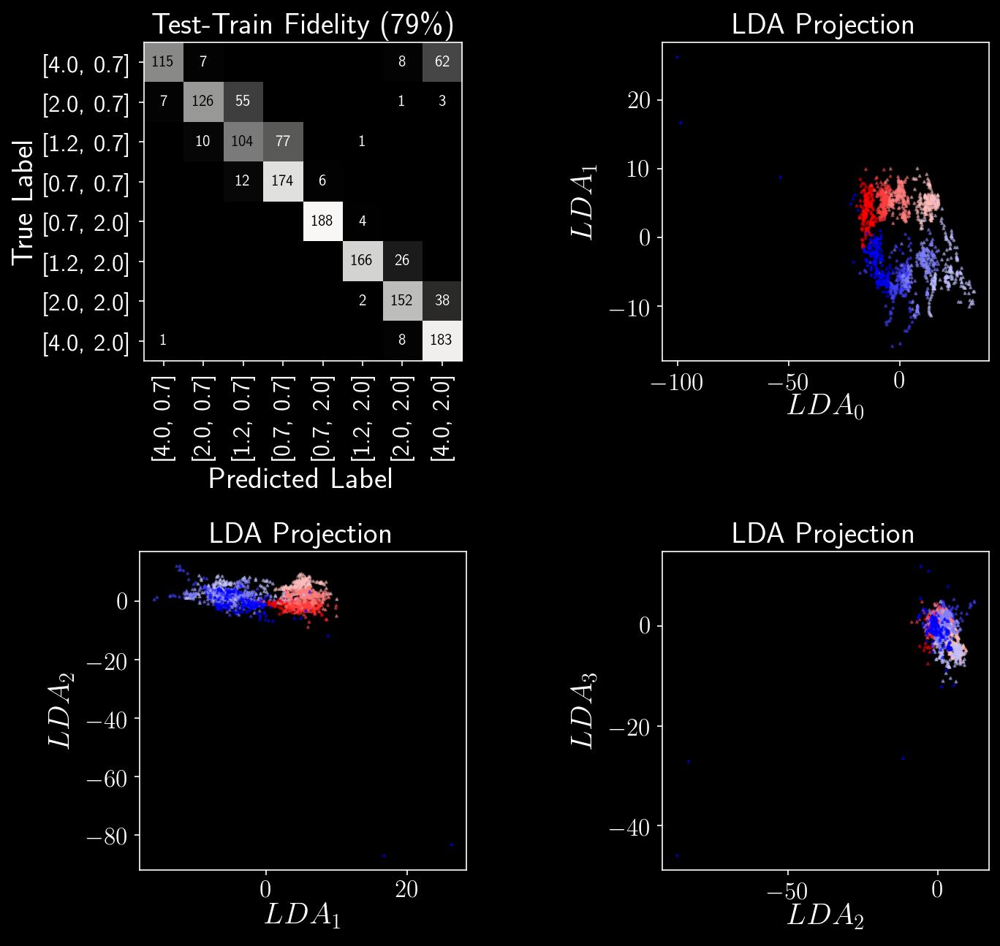

In [51]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 7
train2 = 1

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [52]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fink,S0_on = 1, S1_on = 1, S20_on = 1,S12_on = 1)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[140  18   0   2   0   1  11  20]
 [ 15 164  13   0   0   0   0   0]
 [  1  12 173   5   0   0   1   0]
 [  0   0   3 185   4   0   0   0]
 [  0   0   0   0 191   1   0   0]
 [  0   0   0   0   0 188   4   0]
 [  5   0   0   0   0   5 174   8]
 [  8   0   0   0   0   0  38 146]]
Accuracy0.8860677083333334


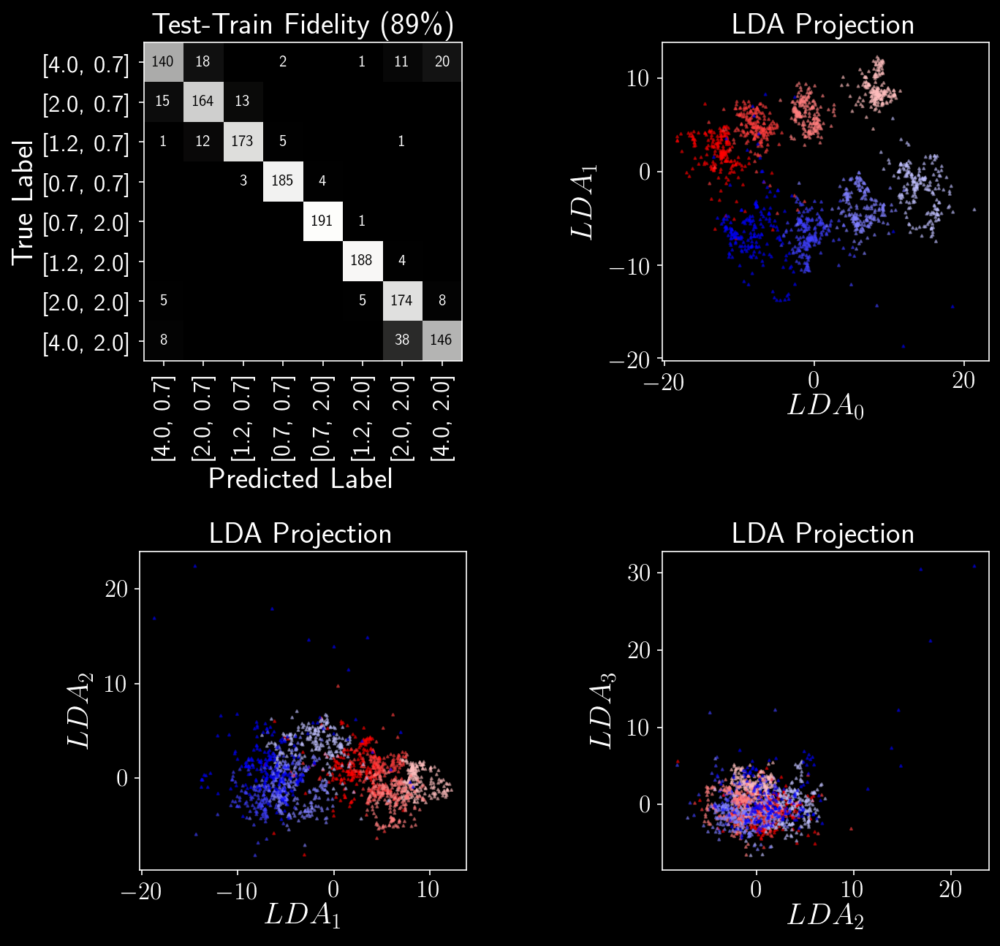

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[145  20   0   0   0   0   5  22]
 [ 20 155  17   0   0   0   0   0]
 [  0   9 143  40   0   0   0   0]
 [  0   0   0 185   7   0   0   0]
 [  0   0   0   0 190   2   0   0]
 [  0   0   0   0   0 181  11   0]
 [  0   0   0   0   0   0 165  27]
 [  2   0   0   0   0   0  19 171]]
Accuracy0.869140625


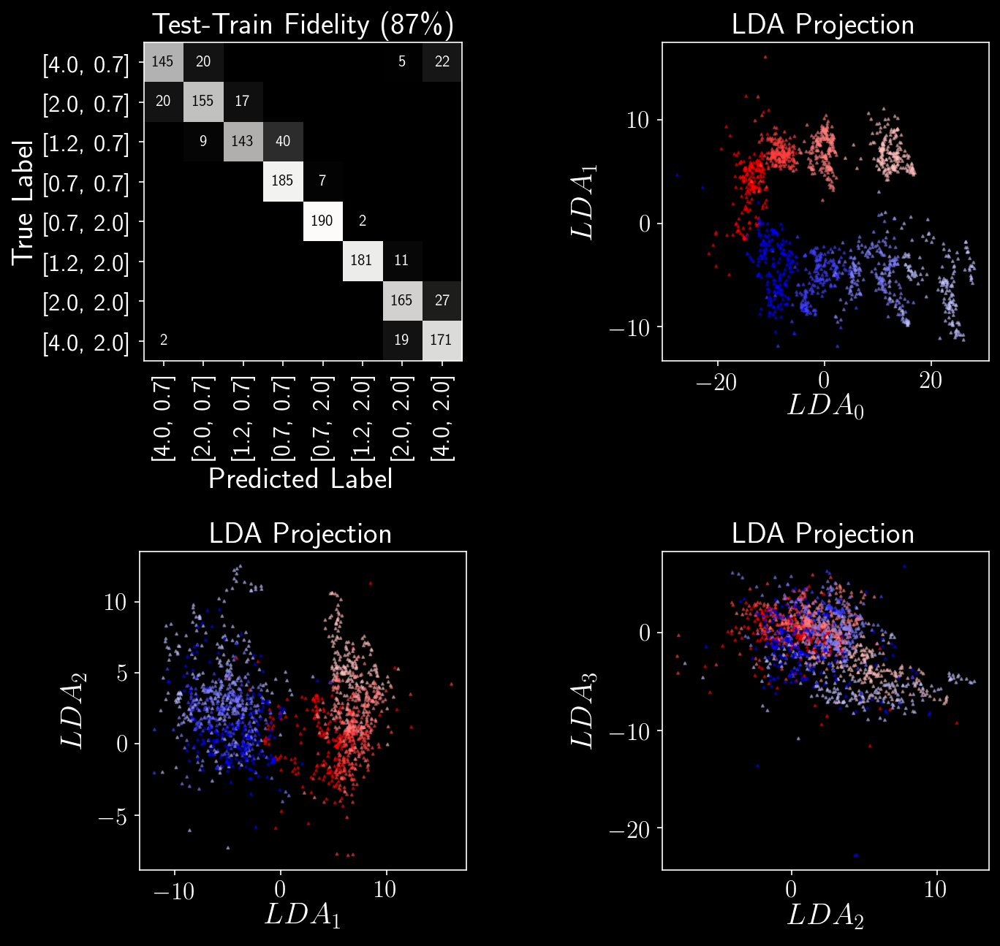

In [53]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 6
train2 = 2

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[150  20   0   0   0   0   4  18]
 [ 16 161   9   0   0   0   6   0]
 [  0  24 139  29   0   0   0   0]
 [  0   0   2 189   1   0   0   0]
 [  0   0   0   0 192   0   0   0]
 [  0   0   0   0   0 180  12   0]
 [  3   0   0   0   0  12 155  22]
 [ 18   0   0   0   0   0  20 154]]
Accuracy0.859375


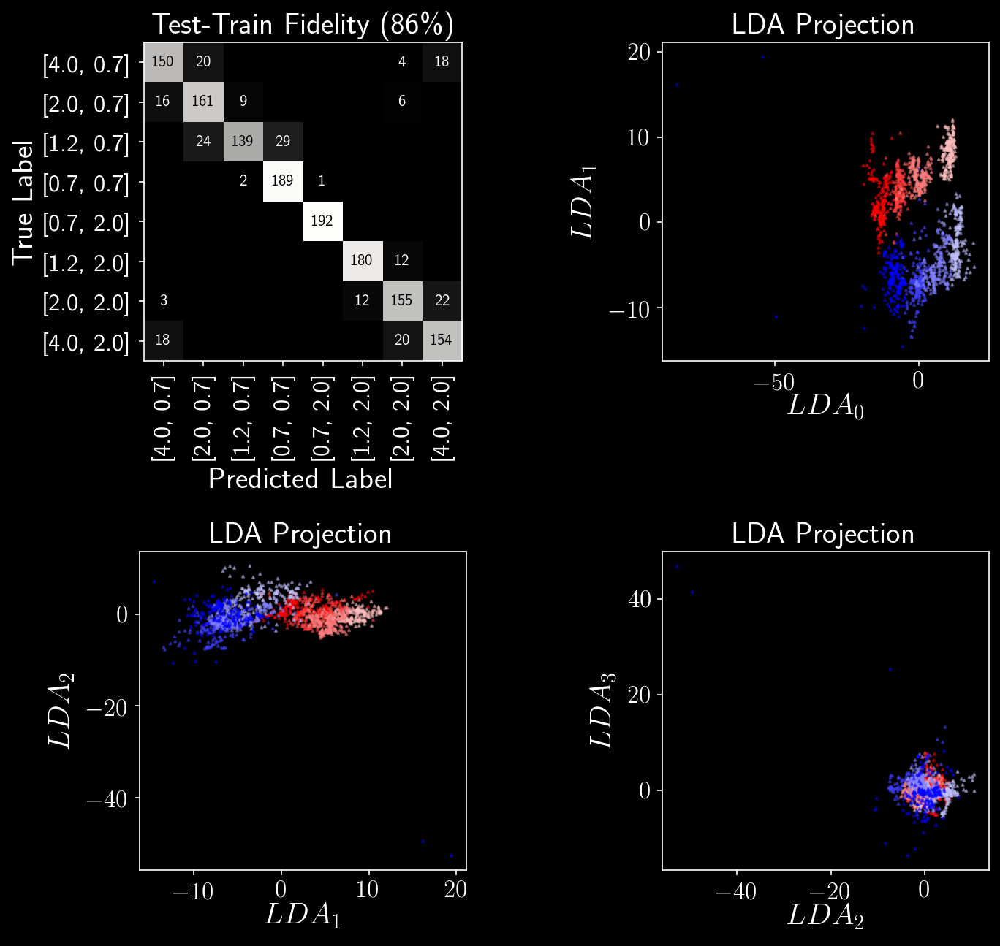

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")


[[119   7   0   0   0   0   7  59]
 [  7 128  54   0   0   1   0   2]
 [  0   6 100  85   0   1   0   0]
 [  0   0  13 174   5   0   0   0]
 [  0   0   0   0 187   5   0   0]
 [  0   0   0   0   0 173  19   0]
 [  0   0   0   0   0   1 154  37]
 [  1   0   0   0   0   0   6 185]]
Accuracy0.7942708333333334


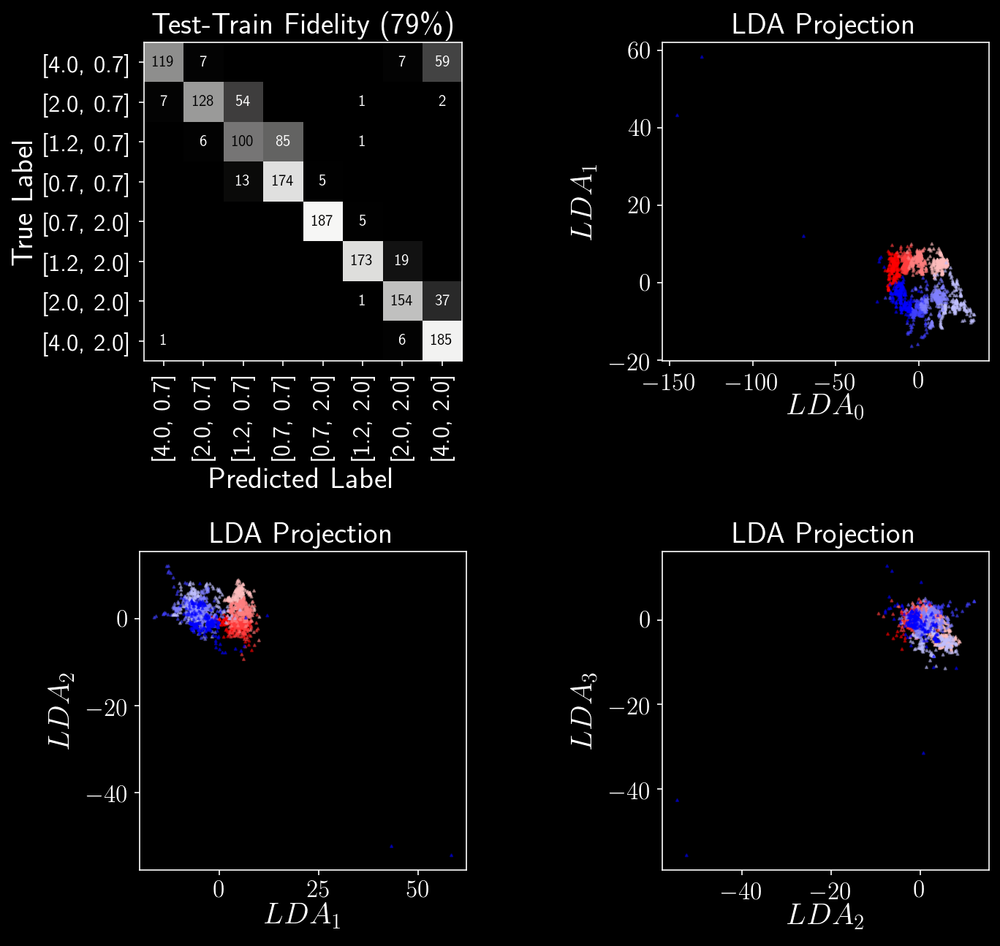

In [54]:
labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
indexes = np.array([list(ele) for ele in indexes])

train1 = 7
train2 = 1

sc = StandardScaler(with_mean=False)
data_pre = sc.fit_transform(out1)
data_in = np.arcsinh(data_pre/.01)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

test = [np.all([np.logical_or(
                np.remainder(ele[0],9)==train1,
                np.remainder(ele[0],9)==train2),
                ele[3]==1]) for ele in indexes]
train = [np.all([np.logical_and(
                 np.remainder(ele[0],9)!=train1,
                 np.remainder(ele[0],9)!=train2),
                 ele[3]==-1]) for ele in indexes]
Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

X_train = data_in[train]
X_test = data_in[test]
Y_train = Y[train]
Y_test = Y[test]

out = LDA_AKS_testman(X_train,Y_train,X_test,Y_test,7,labels)

In [55]:
def LDA_AKS_testman_prec(X_train,y_train,X_test,y_test,n_components,label_list):
    lda = LDA(n_components=n_components)
    sc = StandardScaler()
    X_train = sc.fit_transform(X_train)
    X_test = sc.transform(X_test)
    X_train = lda.fit_transform(X_train, y_train)
    y_pred = lda.predict(X_test)
    X_test = lda.transform(X_test)
    prec = precision_score(y_test, y_pred,average='micro')
    return prec

def extract_precision_invar(data_in_raw,combo_tuple):
    labels = [[4.0,0.7],[2.0,0.7],[1.2,0.7],[0.7,0.7],[0.7,2.0],[1.2,2.0],[2.0,2.0],[4.0,2.0]]
    indexes = [i for i in product(range(0,72),range(0,3),range(0,32),iter([1,-1]))]
    indexes = np.array([list(ele) for ele in indexes])
    
    sc = StandardScaler(with_mean=False)
    data_pre = sc.fit_transform(data_in_raw)
    data_in = np.arcsinh(data_pre/0.01)
    
    test = [np.all([
                    np.remainder(ele[0],9)==combo_tuple[0],
                    ele[3]==1]) for ele in indexes]
    train = [np.all([
                     np.remainder(ele[0],9)!=combo_tuple[0],
                     ele[3]==1]) for ele in indexes]
    Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

    out_same = LDA_AKS_testman_prec(data_in[train],Y[train],data_in[test],Y[test],7,labels)
    
    test = [np.all([
                    np.remainder(ele[0],9)==combo_tuple[0],
                    ele[3]==1]) for ele in indexes]
    train = [np.all([
                     np.remainder(ele[0],9)!=combo_tuple[0],
                     ele[3]==-1]) for ele in indexes]
    Y = np.repeat(np.array([-3,4,1,3,2,-1,-2,-4]),data_in.shape[0]/8)

    out_diff = LDA_AKS_testman_prec(data_in[train],Y[train],data_in[test],Y[test],7,labels)
    return [out_same,out_diff]

In [58]:
from itertools import combinations
withhold_combos = combinations(range(0,9),1)
[i for i in withhold_combos]

[(0,), (1,), (2,), (3,), (4,), (5,), (6,), (7,), (8,)]

In [59]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fink,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

In [61]:
compare_array

array([[0.73177083, 0.73307292],
       [0.76302083, 0.77083333],
       [0.89973958, 0.89713542],
       [0.71484375, 0.69921875],
       [0.82161458, 0.80989583],
       [0.74479167, 0.74088542],
       [0.85416667, 0.84114583],
       [0.74348958, 0.70182292],
       [0.765625  , 0.74609375]])

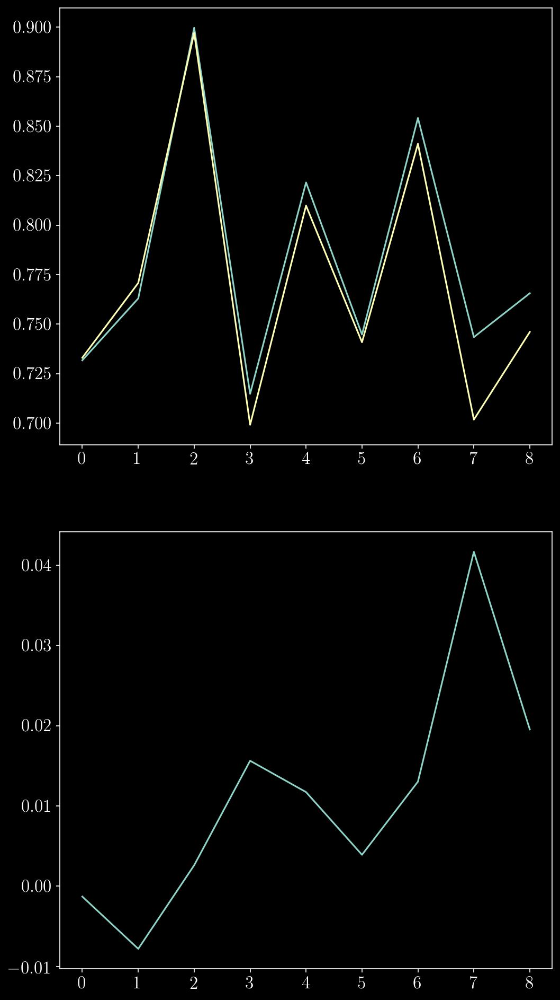

In [68]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [69]:
with open('FromCannon/2020_11_23/DHC_MHD_rinvar_irrat_fink.p', 'rb') as input_file:
    DHC_MHD_rinvar_irrat_fink = np.array(pickle.load(input_file))

In [70]:
out1= DHC_reader_iso(DHC_MHD_rinvar_irrat_fink,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

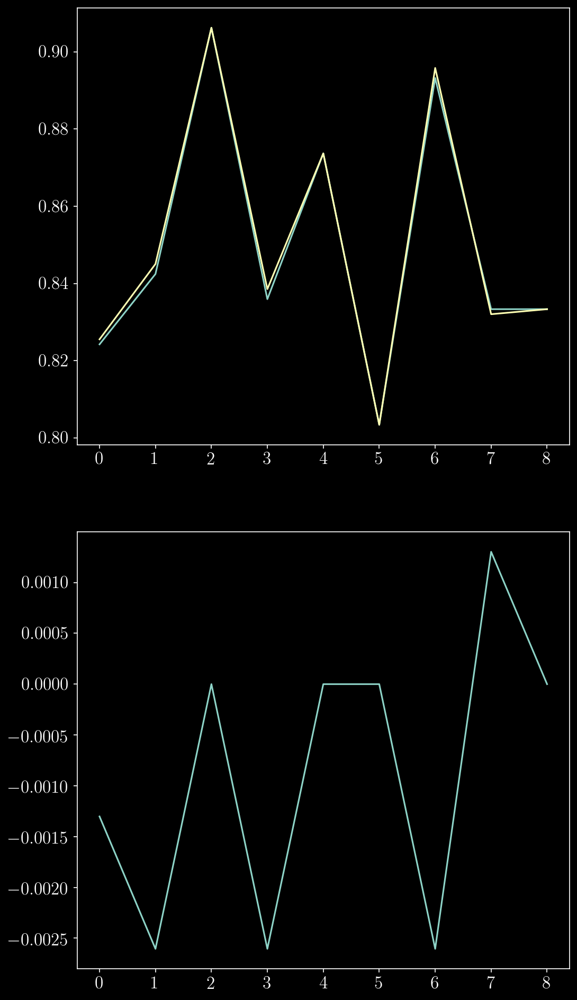

In [71]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [72]:
out1= DHC_reader_iso(DHC_MHD_rinvar_irrat_fink,S0_on = 0, S1_on = 0, S20_on = 0,S12_on = 1)
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-package

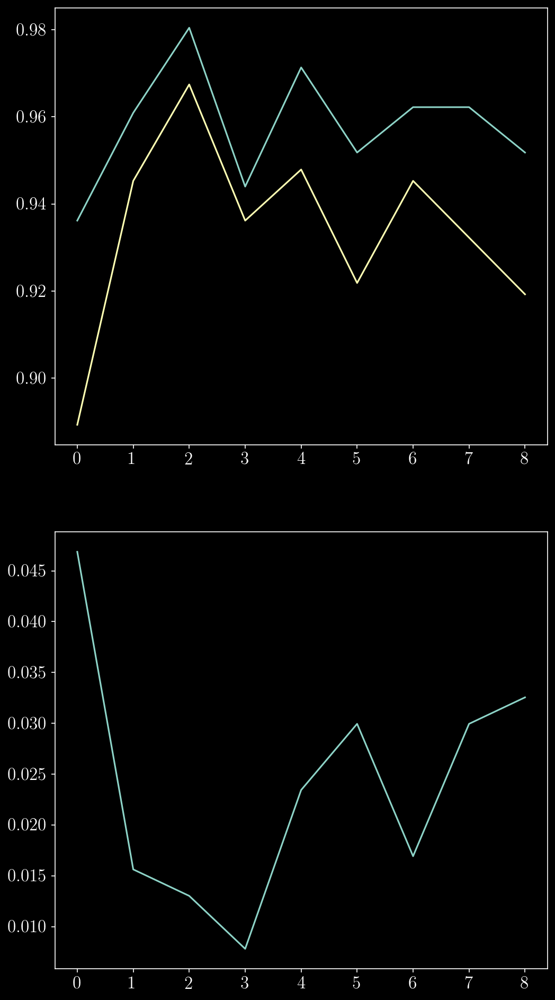

In [73]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [74]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

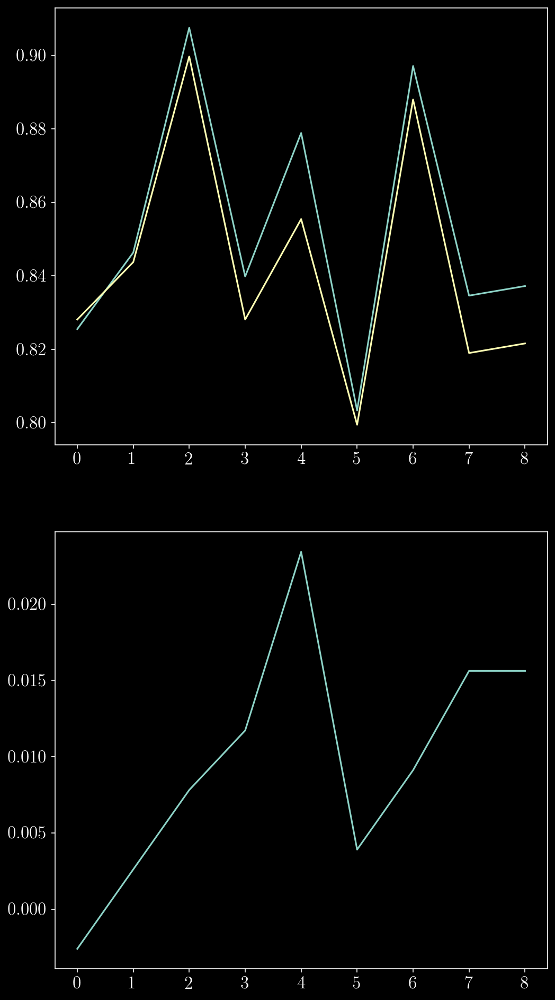

In [75]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [77]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fink,S0_on = 0, S1_on = 0, S20_on = 0,S12_on = 1)
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-package

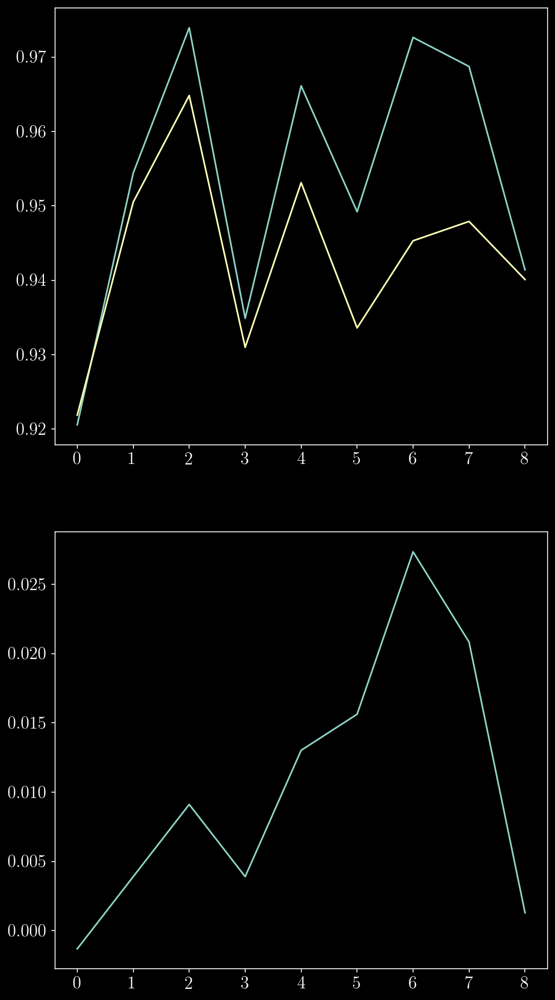

In [78]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [79]:
out1= DHC_reader_iso(DHC_MHD_rinvar_fmor,S0_on = 0, S1_on = 1, S20_on = 0,S12_on = 0)
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-package

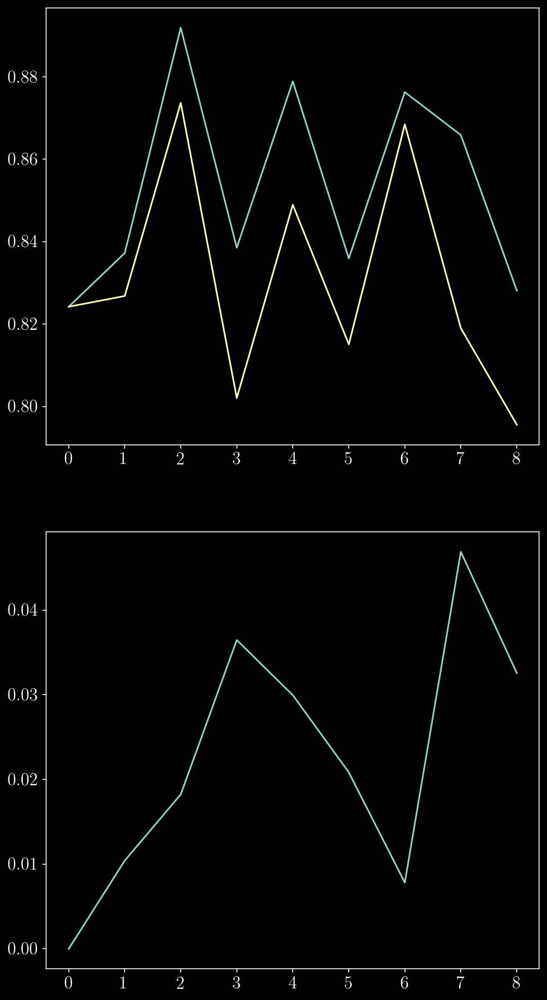

In [80]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [82]:
def DHC_reader_iso(data,S0_on = 1,S1_on = 1, S20_on = 1, S12_on = 1):
    L = 16
    data = np.array(data)
    data0 = np.array([data[i,0].flatten() for i in range(13824)])
    
    data1_raw = np.array([data[i,1] for i in range(13824)])
    data1_iso = np.array([np.sum(data1_raw[i,:,:],axis=1) for i in range(13824)])
    data1 = np.array([data1_iso[i,:].flatten() for i in range(13824)])
    
    data2_raw = np.array([data[i,2] for i in range(13824)])
    data2_iso = [np.sum([data2_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data2_iso = np.moveaxis(np.array(data2_iso), 0, -1)
    
    data2 = np.array([data2_iso[i,:,:,:].flatten() for i in range(13824)])
    
    data3_raw = np.array([data[i,2] for i in range(13824)])
    data3_iso = [np.sum([data3_raw[:,:,:,l,np.remainder(l+d,L)] for d in range(0,L)],axis=0) for l in range(0,L)]
    data3_iso = np.moveaxis(np.array(data3_iso), 0, -1)
    
    data3 = np.array([data3_iso[i,:,:,:].flatten() for i in range(13824)])
    
    if np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 1]):
        out = np.hstack((data1,data3))
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data0,data1,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 1]):
        out = np.hstack((data0,data1))
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 1]):
        out = np.hstack((data1,data2))
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 1]):
        out = data1
        
    elif np.all([S0_on==1,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2,data3))
    elif np.all([S0_on==1,S12_on == 1,S20_on==0,S1_on == 0]):
        out = np.hstack((data0,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==1,S1_on == 0]):
        out = np.hstack((data2,data3))
    elif np.all([S0_on==0,S12_on == 1,S20_on==0,S1_on == 0]):
        out = data3
    elif np.all([S0_on==1,S12_on == 0,S20_on==1,S1_on == 0]):
        out = np.hstack((data0,data2))
    elif np.all([S0_on==1,S12_on == 0,S20_on==0,S1_on == 0]):
        out = data0
    elif np.all([S0_on==0,S12_on == 0,S20_on==1,S1_on == 0]):
        out = data2
    elif np.all([S0_on==0,S12_on == 0,S20_on==0,S1_on == 0]):
        out = np.hstack(([]))
        
    return out

In [83]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fmor16,S0_on = 1, S1_on = 1, S20_on = 0,S12_on = 0)

In [84]:
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-package

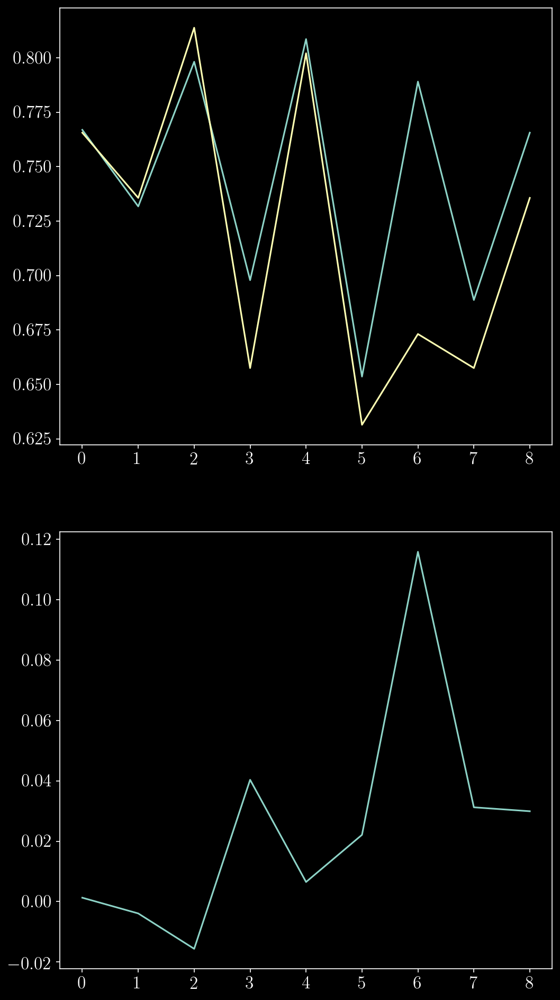

In [85]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])

In [86]:
out1= DHC_reader_iso(DHC_MHD_rinvar_cumsum_fmor16,S0_on = 1, S1_on = 1, S20_on = 1,S12_on = 0)

In [87]:
withhold_combos = combinations(range(0,9),1)
compare_list = []
for i in withhold_combos:
    compare_list.append(extract_precision_invar(out1,i))
compare_array = np.array(compare_list)

/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning: Variables are collinear.
  warnings.warn("Variables are collinear.")
/Users/aksaydjari/miniconda3/envs/RWST/lib/python3.6/site-package

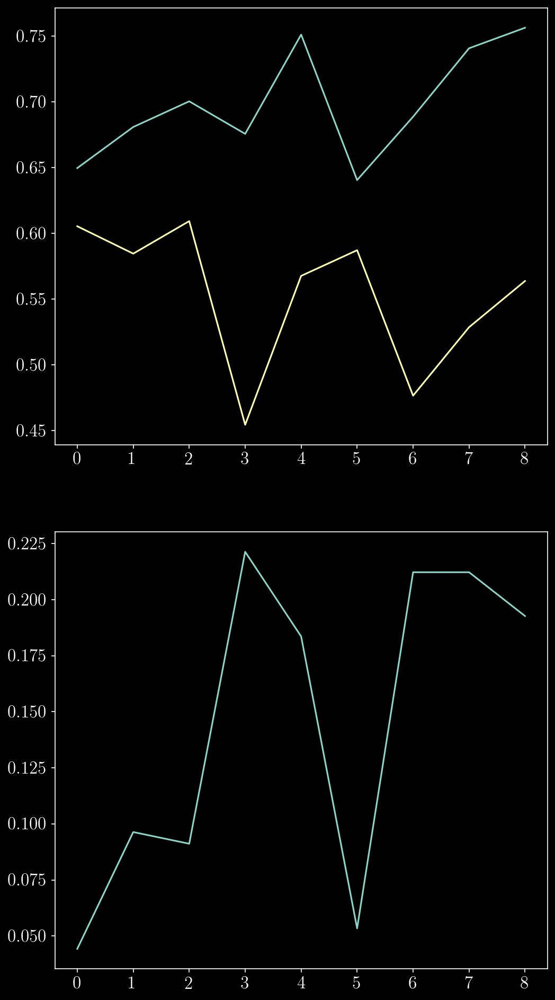

In [88]:
fig = plt.figure(figsize=(8,16), dpi=150)
ax = fig.add_subplot(2,1,1)
ax.plot(compare_array[:,0])
ax.plot(compare_array[:,1])
ax = fig.add_subplot(2,1,2)
ax.plot(compare_array[:,0]-compare_array[:,1])